# ***Packages:***

In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display

# ***EDA:***

In [2]:
# Load the data
df = pd.read_csv('data/Airports2.csv')

In [3]:
# Print the last 5 rows of the dataframe
df.tail()

,Origin_airport,Destination_airport,Origin_city,Destination_city,Passengers,Seats,Flights,Distance,Fly_date,Origin_population,Destination_population,Org_airport_lat,Org_airport_long,Dest_airport_lat,Dest_airport_long
3606798,STL,TBN,"St. Louis, MO","Fort Leonard Wood, MO",281,969,51,119,2009-02-01,2828990,46457,38.748699,-90.370003,37.7416,-92.140701
3606799,STL,TBN,"St. Louis, MO","Fort Leonard Wood, MO",245,1026,54,119,2009-11-01,2828990,46457,38.748699,-90.370003,37.7416,-92.140701
3606800,STL,TBN,"St. Louis, MO","Fort Leonard Wood, MO",363,1273,67,119,2009-08-01,2828990,46457,38.748699,-90.370003,37.7416,-92.140701
3606801,CGI,TBN,"Cape Girardeau, MO","Fort Leonard Wood, MO",2,19,1,146,2009-08-01,93712,46457,37.225300,-89.570801,37.7416,-92.140701
3606802,FWA,OH1,"Fort Wayne, IN","Washington Court House, OH",0,0,1,135,2003-09-01,398574,28133,40.978500,-85.195099,NaN,NaN


In [5]:
# print the number of null values in the dataset
print("Number of NULL values:")
print(df.isnull().sum())


# print the number of duplicate rows in the dataframe
print('Number of duplicates:')
print(df.duplicated().sum())

Number of NULL values:
Origin_airport               0
Destination_airport          0
Origin_city                  0
Destination_city             0
Passengers                   0
Seats                        0
Flights                      0
Distance                     0
Fly_date                     0
Origin_population            0
Destination_population       0
Org_airport_lat           6954
Org_airport_long          6954
Dest_airport_lat          6807
Dest_airport_long         6807
dtype: int64
Number of duplicates:
41753


In [ ]:
# number of rows and columns in the dataframe
print(df.shape)

(3606803, 15)


In [7]:
# type of data in the dataframe
print(df.dtypes)

Origin_airport             object
Destination_airport        object
Origin_city                object
Destination_city           object
Passengers                  int64
Seats                       int64
Flights                     int64
Distance                    int64
Fly_date                   object
Origin_population           int64
Destination_population      int64
Org_airport_lat           float64
Org_airport_long          float64
Dest_airport_lat          float64
Dest_airport_long         float64
dtype: object


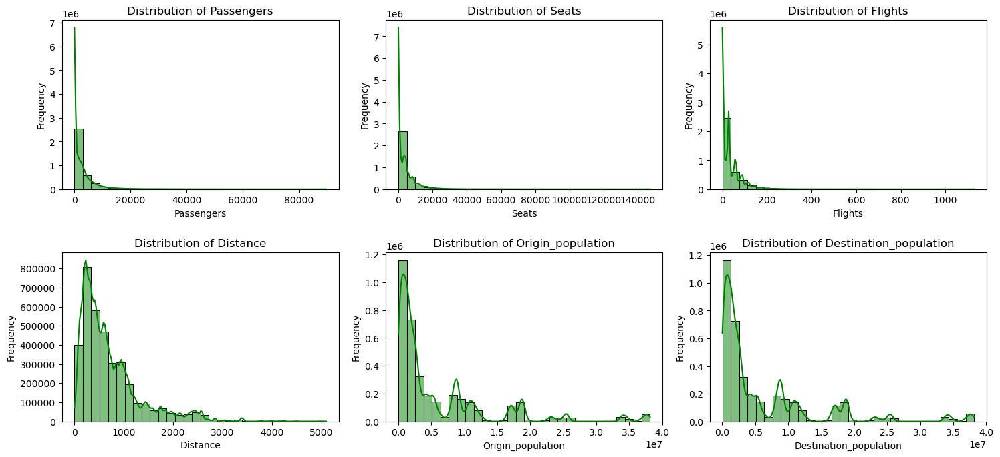

In [42]:
# histograms of distribution of: passengers, seats, flights, distance, origin population, destination population

# columns to plot
columns = ['Passengers', 'Seats', 'Flights', 'Distance', 'Origin_population', 'Destination_population']

# figure size
plt.figure(figsize=(15, 10))

# plot each column
for i, col in enumerate(columns, 1):
    plt.subplot(len(columns) // 3 + 1, 3, i) 
    sns.histplot(df[col], kde=True, bins=30, color='green')  # Histograms with KDE
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')

# figures' layout
plt.tight_layout()

# show the plots
plt.show()



In [8]:
# Most common routes

# Create a column "Route" that concatenates the origin and destination airports
df['Route'] = df['Origin_airport'] + " → " + df['Destination_airport']

# Group by the new column and sum the number of flights
common_routes = df.groupby('Route')['Flights'].sum().sort_values(ascending=False)

# Print the 10 most common routes
print("Most Common Routes:")
print(common_routes.head(10))

Most Common Routes:
Route
OGG → HNL    394909
HNL → OGG    389964
LAX → SFO    324666
SFO → LAX    311783
LAX → LAS    296392
LAS → LAX    291759
PDX → SEA    285317
SEA → PDX    280390
PHX → LAX    258612
LAX → PHX    256481
Name: Flights, dtype: int64


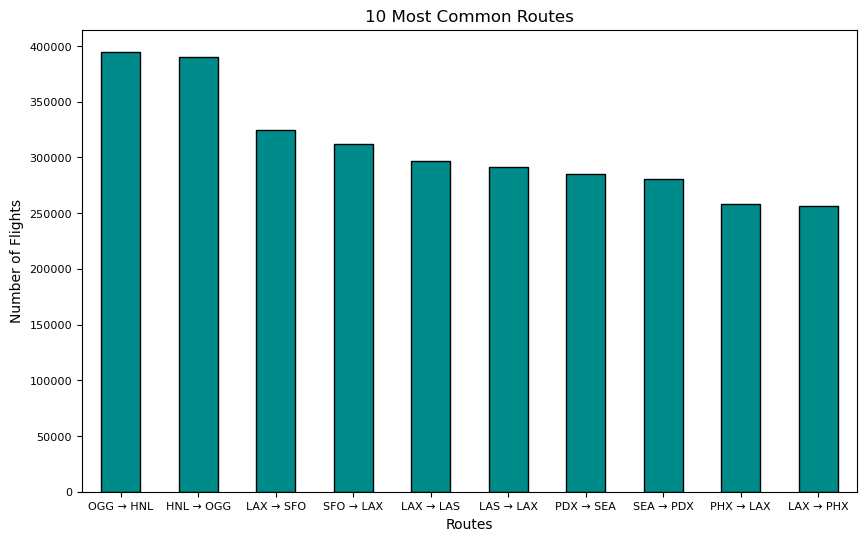

In [9]:
# Plot of the 10 most common routes
common_routes.head(10).plot(kind='bar', figsize=(10, 6), color='darkcyan', edgecolor='black')
plt.title("10 Most Common Routes")
plt.xlabel("Routes")
plt.ylabel("Number of Flights")
plt.xticks(rotation=0, fontsize=8)
plt.yticks(fontsize=8)
plt.show()

In [10]:
# Gropu by the origin airport and sum the number of flights
top_origin_airports = df.groupby('Origin_airport')['Flights'].sum().sort_values(ascending=False)

# Print the 10 airports with the most flights
print("Origin Airports with the biggest number of flights:")
print(top_origin_airports.head(10))


Origin Airports with the biggest number of flights:
Origin_airport
ORD    6908482
ATL    6558015
DFW    5994638
LAX    4099901
DTW    3452613
PHX    3213108
MSP    3204923
IAH    3195062
STL    3181102
CLT    2840773
Name: Flights, dtype: int64


In [11]:
# Group by the destination airport and sum the number of flights
top_destination_airports = df.groupby('Destination_airport')['Flights'].sum().sort_values(ascending=False)

# Print the 10 airports with the most flights
print("Destination Airports with the biggest number of flights:")
print(top_destination_airports.head(10))


Destination Airports with the biggest number of flights:
Destination_airport
ORD    6896285
ATL    6544759
DFW    5987886
LAX    4096702
DTW    3448042
PHX    3208877
MSP    3200182
IAH    3196768
STL    3177639
CLT    2837107
Name: Flights, dtype: int64


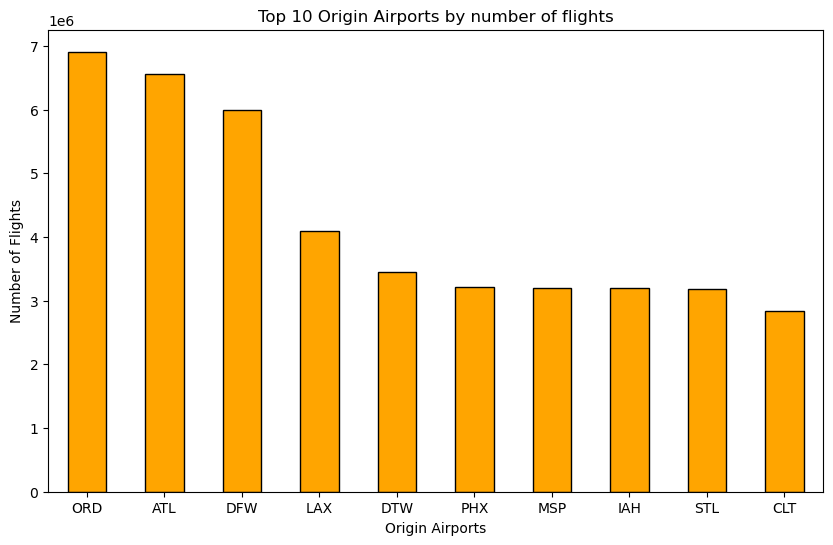

In [12]:
top_origin_airports.head(10).plot(kind='bar', figsize=(10, 6), color='orange', edgecolor='black')
plt.title("Top 10 Origin Airports by number of flights")
plt.xlabel("Origin Airports")
plt.ylabel("Number of Flights")
plt.xticks(fontsize = 10, rotation = 0)
plt.yticks(fontsize = 10)
plt.show()


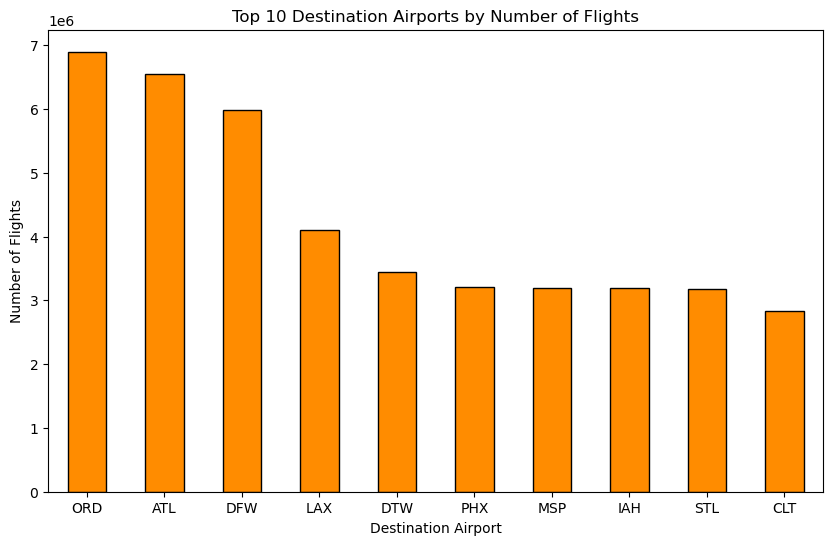

In [13]:
top_destination_airports.head(10).plot(kind='bar', figsize=(10, 6), color='darkorange', edgecolor='black')
plt.title("Top 10 Destination Airports by Number of Flights")
plt.xlabel("Destination Airport")
plt.ylabel("Number of Flights")
plt.xticks(rotation=0, fontsize=10)
plt.show()


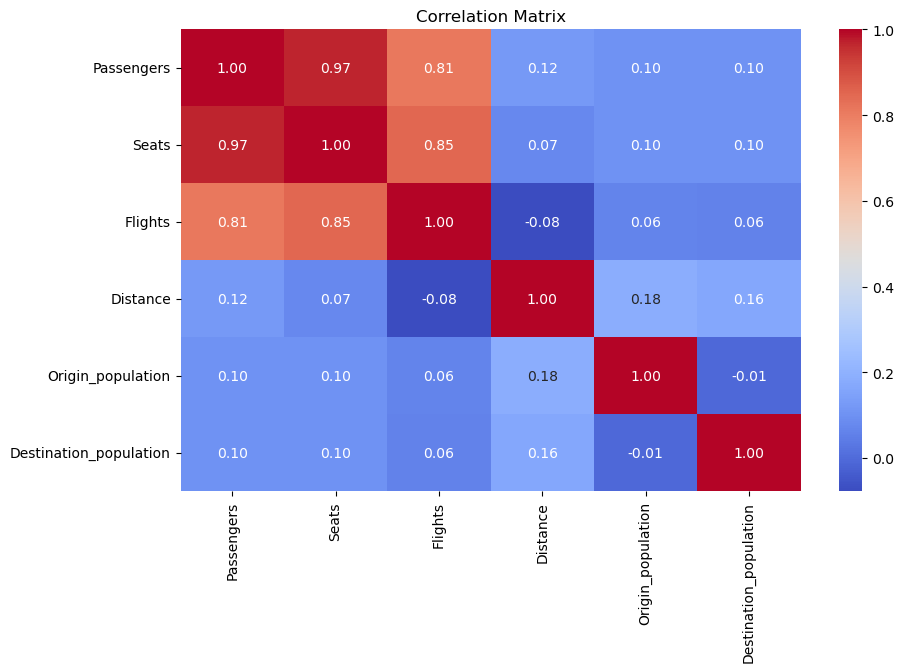

In [14]:
# heatmap of the correlation matrix of the numerical columns

num_features = df[['Passengers', 'Seats', 'Flights', 'Distance', 'Origin_population', 'Destination_population']]

plt.figure(figsize=(10, 6))
sns.heatmap(num_features.corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix')
plt.show()

# ***[Q1] Flight Network Analysis:***

In [ ]:
import networkx as nx

# Create a directed graph from the dataframe
flight_network = nx.from_pandas_edgelist(df, source='Origin_airport', target='Destination_airport', edge_attr='Distance', create_using=nx.DiGraph)

### **1.1 Implement a function analyze_graph_features(flight_network) that takes the flight network as input and computes the following:**

- Count the number of airports (nodes) and flights (edges) in the graph.
- Compute the density of the graph using the formula: 
$$
Density = \frac{2 \cdot E}{N \cdot (N-1)}
$$
- Calculate both in-degree and out-degree for each airport and visualize them using histograms.
- Identify airports with degrees higher than the 90th percentile and list them as "hubs."
- Determine if the graph is sparse or dense based on its density.

In [6]:
def nodes(flight_network):
    origin_air = set(flight_network['Origin_airport'])
    dest_air = set(flight_network['Destination_airport'])
    nodes = origin_air.union(dest_air)
    num_nodes = len(nodes)
    return num_nodes

def edges(flight_network):
    edges = flight_network.groupby(['Origin_airport', 'Destination_airport']).size()
    num_edges = len(edges)
    return num_edges

def density(num_nodes, num_edges):
    if num_nodes > 1:
        density = 2*(num_edges) / (num_nodes * (num_nodes - 1))
    else:
        density = 0
    return density

def calculate_degrees(flight_network):
    in_degree = {}
    out_degree = {}
    
    for _, row in flight_network.iterrows():
        origin = row['Origin_airport']
        destination = row['Destination_airport']
        
        # Increases out_degree for the origin airport
        if origin not in out_degree:
            out_degree[origin] = 0
        out_degree[origin] += 1
        
        # Increases in_degree for the destination airport
        if destination not in in_degree:
            in_degree[destination] = 0
        in_degree[destination] += 1
    
    return in_degree, out_degree

def identify_hubs(in_degree, out_degree):
    # Calculate the total degree for each node
    total_degree = {node: in_degree.get(node, 0) + out_degree.get(node, 0) for node in set(in_degree) | set(out_degree)}
    
    # Calculate the 90% percentile of the total degree values
    degree_values = list(total_degree.values())
    threshold = np.percentile(degree_values, 90)
    
    # Identify the hubs
    hubs = {node: degree for node, degree in total_degree.items() if degree > threshold}
    return hubs

def is_dense(density):
    return density >= 0.5





In [7]:
# Final Function to analyze the graph features
def analyze_graph_features(flight_network):

    num_nodes = nodes(flight_network)

    num_edges = edges(flight_network)

    graph_density = density(num_nodes, num_edges)

    in_degree, out_degree = calculate_degrees(flight_network)

    hubs = identify_hubs(in_degree, out_degree)

    graph_type = "Dense" if is_dense(graph_density) else "Sparse"
    
    return {
        "num_nodes": num_nodes,
        "num_edges": num_edges,
        "density": graph_density,
        "graph_type": graph_type,
        "hubs": hubs,
        "in_degree": in_degree,
        "out_degree": out_degree
    }



In [8]:
analyze_graph_features(df)

{'num_nodes': 727,
 'num_edges': 36719,
 'density': 0.1391392984490396,
 'graph_type': 'Sparse',
 'hubs': {'OAK': 45120,
  'PVD': 32799,
  'RDU': 66757,
  'ABQ': 43594,
  'SMF': 30357,
  'BWI': 96973,
  'GEG': 23380,
  'IAD': 96185,
  'LAX': 171376,
  'PDX': 67699,
  'DFW': 216929,
  'SFO': 114393,
  'ANC': 52290,
  'SJC': 37901,
  'ROC': 32157,
  'ALB': 27372,
  'BUF': 39514,
  'FLL': 71346,
  'DAL': 26500,
  'SAT': 43876,
  'MDW': 55171,
  'LIT': 26151,
  'DTW': 198972,
  'MSY': 60425,
  'JAX': 41611,
  'GRR': 21775,
  'ORD': 318550,
  'CMH': 58910,
  'TUL': 28985,
  'RIC': 32844,
  'DSM': 22046,
  'BNA': 71701,
  'IAH': 165209,
  'BDL': 52827,
  'EWR': 162228,
  'SAN': 54911,
  'AUS': 46016,
  'JFK': 108489,
  'TPA': 82035,
  'OKC': 33566,
  'SLC': 94322,
  'MCI': 78028,
  'GSO': 36276,
  'BOS': 113358,
  'PHL': 165742,
  'MCO': 125913,
  'PBI': 35726,
  'ELP': 32677,
  'CLE': 112099,
  'PIT': 139796,
  'SYR': 30506,
  'DCA': 93099,
  'MKE': 61750,
  'MSP': 197492,
  'HOU': 41972,
 

### **1.2 Write a function summarize_graph_features(flight_network) that generates a detailed report of the graph's features. A summary report needs to include:**

- The number of nodes and edges.
- The graph density.
- Degree distribution plots for in-degree and out-degree.
- A table of identified hubs.



In [10]:
def summarize_graph_features(flight_network):

    # Step 1: Compute the number of nodes and edges

    num_nodes = nodes(flight_network)
    num_edges = edges(flight_network)
    
    # Step 2: Calculate the graph density

    graph_density = density(num_nodes, num_edges)
    
    # Step 3: Compute in-degree and out-degree

    in_degree, out_degree = calculate_degrees(flight_network)
    
    # Step 4: Identify hubs

    hubs = identify_hubs(in_degree, out_degree)
    
    # Step 5: Generate degree distribution plots

    # Convert in-degree and out-degree dictionaries to lists
    in_degree_values = list(in_degree.values())
    out_degree_values = list(out_degree.values())
    
    # Create subplots for the distributions
    plt.figure(figsize=(12, 6))
    
    # In-degree distribution
    plt.subplot(1, 2, 1)
    plt.hist(in_degree_values, bins=50, color='skyblue', alpha=0.7, )
    plt.title('In-Degree Distribution')
    plt.xlabel('In-Degree')
    plt.ylabel('Frequency')
    plt.xlim(0, 50000)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    
    # Out-degree distribution
    plt.subplot(1, 2, 2)
    plt.hist(out_degree_values, bins=50, color='salmon', alpha=0.7)
    plt.title('Out-Degree Distribution')
    plt.xlabel('Out-Degree')
    plt.ylabel('Frequency')
    plt.xlim(0, 50000)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    
    # Adjust layout and show the plots
    plt.tight_layout()
    plt.show()
    
    # Step 6: Display the hubs as a DataFrame
    
    hubs_df = pd.DataFrame(list(hubs.items()), columns=['Airport', 'Degree'])
    hubs_df = hubs_df.sort_values(by='Degree', ascending=False)
    
    # Print the summary report
    print("----- Graph Summary Report -----")
    print(f"Number of nodes (airports): {num_nodes}")
    print(f"Number of edges (routes): {num_edges}")
    print(f"Graph density: {graph_density:.4f}")
    print(f"Graph type: {'Dense' if graph_density >= 0.5 else 'Sparse'}")
    
    # Display the hubs table using IPython's display function
    print("\n--- Hubs Table (Top 10 Hubs) ---")
    display(hubs_df.head(10))
    
    # Return the detailed summary as a dictionary
    return {
        "num_nodes": num_nodes,
        "num_edges": num_edges,
        "density": graph_density,
        "graph_type": "Dense" if graph_density >= 0.5 else "Sparse",
        "hubs": hubs_df
    }

    
    
    

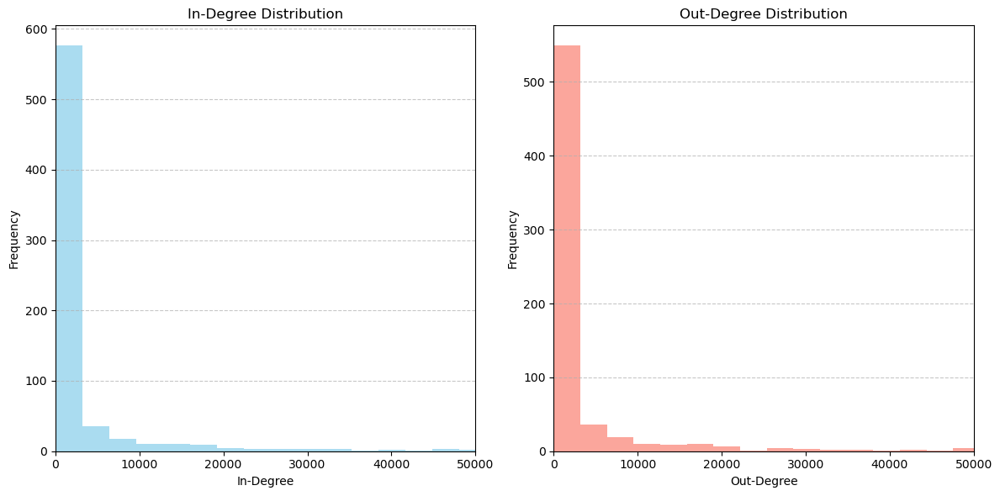

----- Graph Summary Report -----
Number of nodes (airports): 727
Number of edges (routes): 36719
Graph density: 0.1391
Graph type: Sparse

--- Hubs Table (Top 10 Hubs) ---


,Airport,Degree
26,ORD,318550
70,ATL,263825
10,DFW,216929
22,DTW,198972
53,MSP,197492
8,LAX,171376
55,CLT,170684
44,PHL,165742
32,IAH,165209
34,EWR,162228


{'num_nodes': 727,
 'num_edges': 36719,
 'density': 0.1391392984490396,
 'graph_type': 'Sparse',
 'hubs':    Airport  Degree
 26     ORD  318550
 70     ATL  263825
 10     DFW  216929
 22     DTW  198972
 53     MSP  197492
 ..     ...     ...
 67     SNA   25118
 6      GEG   23380
 66     TUS   22171
 30     DSM   22046
 25     GRR   21775
 
 [73 rows x 2 columns]}

In [11]:
summarize_graph_features(df)

### **1.3 Now let's dive deeper into the analysis of the dataset. Do the following:**

- Compute total passenger flow between origin and destination cities.

- Identify and visualize the busiest routes by passenger traffic.

- Calculate the average passengers per flight for each route and highlight under/over-utilized connections.

- Create an interactive map visualizing the geographic spread of the flight network.

In [12]:
def compute_passenger_flow(flight_network):
    passenger_flow = flight_network.groupby(['Origin_city', 'Destination_city'])['Passengers'].sum().reset_index()
    passenger_flow = passenger_flow.sort_values(by='Passengers', ascending=False)
    return passenger_flow

def visualize_busiest_routes(passenger_flow, top_n=10):
    top_routes = passenger_flow.head(top_n)
    plt.figure(figsize=(12, 6))
    plt.barh(top_routes['Origin_city'] + " → " + top_routes['Destination_city'], top_routes['Passengers'], color='skyblue', edgecolor='black')
    plt.xlabel('Total Passengers')
    plt.ylabel('Routes')
    plt.title(f'Top {top_n} Busiest Routes by Passenger Traffic')
    plt.gca().invert_yaxis()  # Invert y-axis for better readability
    plt.show()

In [13]:
passenger_flow = compute_passenger_flow(df)
display(passenger_flow.head(10))  # Display top 10 city pairs by passenger flow


,Origin_city,Destination_city,Passengers
7122,"Dallas, TX","Houston, TX",38295025
12391,"Houston, TX","Dallas, TX",37989016
13585,"Kahului, HI","Honolulu, HI",32364664
12259,"Honolulu, HI","Kahului, HI",29744742
16133,"Los Angeles, CA","Honolulu, HI",28964232
12264,"Honolulu, HI","Los Angeles, CA",28632161
16083,"Los Angeles, CA","Chicago, IL",26751937
5323,"Chicago, IL","Los Angeles, CA",26645096
15218,"Las Vegas, NV","Los Angeles, CA",26333721
16152,"Los Angeles, CA","Las Vegas, NV",26177809


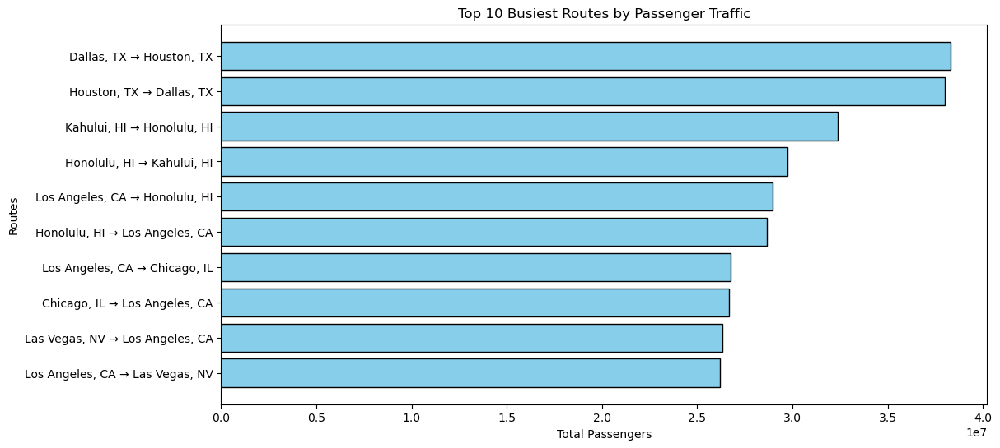

In [14]:
visualize_busiest_routes(passenger_flow)


In [15]:
def analyze_route_utilization(flight_network):
    route_stats = flight_network.groupby(['Origin_city', 'Destination_city']).agg(
        total_passengers=('Passengers', 'sum'),
        total_flights=('Flights', 'sum'),
        total_seats=('Seats', 'sum')
    ).reset_index()
    
    # Calculate averages
    route_stats['avg_passengers_per_flight'] = route_stats['total_passengers'] / route_stats['total_flights']
    route_stats['avg_seat_capacity'] = route_stats['total_seats'] / route_stats['total_flights']
    
    # Determine under/over-utilized routes
    route_stats['utilization'] = route_stats['avg_passengers_per_flight'] / route_stats['avg_seat_capacity']
    route_stats['utilization_status'] = route_stats['utilization'].apply(
        lambda x: 'Under-utilized' if x < 0.5 else 'Over-utilized' if x > 1 else 'Well-utilized'
    )

    # fill na values
    route_stats.fillna(0, inplace=True)
    
    return route_stats


In [16]:
route_utilization = analyze_route_utilization(df)
display(route_utilization)  # Display route utilization statistics


,Origin_city,Destination_city,total_passengers,total_flights,total_seats,avg_passengers_per_flight,avg_seat_capacity,utilization,utilization_status
0,"Aberdeen, SD","Anchorage, AK",2,1,9,2.0,9.0,0.222222,Under-utilized
1,"Aberdeen, SD","Billings, MT",100,1,100,100.0,100.0,1.000000,Well-utilized
2,"Aberdeen, SD","Bismarck, ND",67,2,68,33.5,34.0,0.985294,Well-utilized
3,"Aberdeen, SD","Brainerd, MN",32,1,37,32.0,37.0,0.864865,Well-utilized
4,"Aberdeen, SD","Eau Claire, WI",32,1,34,32.0,34.0,0.941176,Well-utilized
...,...,...,...,...,...,...,...,...,...
30326,"Yuma, AZ","Yuma, AZ",0,2,38,0.0,19.0,0.000000,Under-utilized
30327,"Zanesville, OH","Atlanta, GA",0,5,0,0.0,0.0,0.000000,Well-utilized
30328,"Zanesville, OH","Detroit, MI",0,3,0,0.0,0.0,0.000000,Well-utilized
30329,"Zanesville, OH","Kansas City, MO",0,1,0,0.0,0.0,0.000000,Well-utilized


In [20]:
# print over-utilized routes

over_utilized_routes = route_utilization[route_utilization['utilization_status'] == 'Over-utilized']
over_utilized_routes

,Origin_city,Destination_city,total_passengers,total_flights,total_seats,avg_passengers_per_flight,avg_seat_capacity,utilization,utilization_status
22606,"Raleigh, NC","Parkersburg, WV",60,1,59,60.0,59.0,1.016949,Over-utilized


**Now we're going to create a copy of the principal dataframe (df) called df3. It'll be processed with the function we've written below and then we'll use this new dataframe to create the interactive map and to do Q4**

In [8]:
import pandas as pd

def preprocess_flight_data(flight_network):
    # Remove duplicate rows
    flight_network = flight_network.drop_duplicates(subset=['Origin_airport', 'Destination_airport'])
    
    # Remove flights with the same origin and destination airport
    flight_network = flight_network[flight_network['Origin_airport'] != flight_network['Destination_airport']]
    
    # Remove flights with zero passengers or seats
    flight_network = flight_network[(flight_network['Passengers'] > 0) & (flight_network['Seats'] > 0)]
    
    return flight_network

In [18]:
df3 = df.copy()

In [19]:
preprocess_flight_data(df3)

,Origin_airport,Destination_airport,Origin_city,Destination_city,Passengers,Seats,Flights,Distance,Fly_date,Origin_population,Destination_population,Org_airport_lat,Org_airport_long,Dest_airport_lat,Dest_airport_long
0,MHK,AMW,"Manhattan, KS","Ames, IA",21,30,1,254,2008-10-01,122049,86219,39.140999,-96.670799,NaN,NaN
1,EUG,RDM,"Eugene, OR","Bend, OR",41,396,22,103,1990-11-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
9,SEA,RDM,"Seattle, WA","Bend, OR",8,18,1,228,1990-02-01,5154164,76034,47.449001,-122.308998,44.254101,-121.150002
14,PDX,RDM,"Portland, OR","Bend, OR",349,851,23,116,1990-01-01,1534762,76034,45.588699,-122.598000,44.254101,-121.150002
38,LMT,RDM,"Klamath Falls, OR","Bend, OR",139,396,22,147,1990-01-01,57948,76034,42.156101,-121.733002,44.254101,-121.150002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3606577,FSM,TBN,"Fort Smith, AR","Fort Leonard Wood, MO",26,114,6,207,1991-04-01,236532,41855,35.336601,-94.367401,37.741600,-92.140701
3606578,STL,TBN,"St. Louis, MO","Fort Leonard Wood, MO",224,931,49,119,1991-12-01,2595543,41855,38.748699,-90.370003,37.741600,-92.140701
3606757,MWA,TBN,"Marion, IL","Fort Leonard Wood, MO",3,19,1,171,2007-12-01,64248,44402,37.755001,-89.011101,37.741600,-92.140701
3606770,MCI,TBN,"Kansas City, MO","Fort Leonard Wood, MO",276,1083,57,176,2008-10-01,2046083,44760,39.297600,-94.713898,37.741600,-92.140701


In [21]:
import folium
from folium.plugins import MarkerCluster

def plot_flight_network(df):
    """
    Visualize the flight network on a map using Folium.
    Parameters:
        df: DataFrame containing the flight network data with the following columns:
            - Org_airport_lat, Org_airport_long 
            - Dest_airport_lat, Dest_airport_long 
            - Origin_airport, Destination_airport 
    """
    # Calculate the average latitude and longitude
    avg_lat = (df['Org_airport_lat'].mean() + df['Dest_airport_lat'].mean()) / 2
    avg_lon = (df['Org_airport_long'].mean() + df['Dest_airport_long'].mean()) / 2

    # Creating the Folium Map
    m = folium.Map(location=[avg_lat, avg_lon], zoom_start=5, tiles="OpenStreetMap")

    # Grouping of the markers to avoid overcrowding on the map
    marker_cluster = MarkerCluster().add_to(m)

    # Add nodes (airports) as markers
    for _, row in df.iterrows():
        folium.Marker(
            location=[row['Org_airport_lat'], row['Org_airport_long']],
            popup=f"Origin: {row['Origin_airport']}",
            icon=folium.Icon(color="blue", icon="plane", prefix="fa")
        ).add_to(marker_cluster)

        folium.Marker(
            location=[row['Dest_airport_lat'], row['Dest_airport_long']],
            popup=f"Destination: {row['Destination_airport']}",
            icon=folium.Icon(color="red", icon="plane", prefix="fa")
        ).add_to(marker_cluster)

    # Add edges (routes) as lines
    for _, row in df.iterrows():
        folium.PolyLine(
            locations=[
                [row['Org_airport_lat'], row['Org_airport_long']],
                [row['Dest_airport_lat'], row['Dest_airport_long']]
            ],
            color="blue",
            weight=1,
            opacity=0.7,
            tooltip=f"Route: {row['Origin_airport']} → {row['Destination_airport']}"
        ).add_to(m)

    return m

In [22]:
# Select the top 10000 routes based on the number of passengers
top_routes = df3.sort_values(by='Passengers', ascending=False).head(10000)

# viualize the top 10000 routes on a map
flight_map = plot_flight_network(top_routes)
flight_map.save("top_routes_map.html")
flight_map

## ***Questions & Answers:***

### ***Question:***

- Is the graph sparse or dense?
- What patterns do you observe in the degree distribution?
- Which airports are identified as hubs, and why?
- What are the busiest routes in terms of passenger traffic?
- Which routes are under/over-utilized?

### ***Answers:***

- The graph density is very low (0.00139), confirming that this is a sparse network, with most nodes not directly connected to each other.
- The degree distribution is highly imbalanced, with most airports having very low in-degree and out-degree values. Only a few airports (hubs) exhibit extremely high degrees, acting as key network centers. High-degree airports (hubs) are critical to the network’s functionality. Disruptions at these hubs can significantly affect the entire system.
- Airports like ORD (O’Hare International), ATL (Hartsfield-Jackson Atlanta), and DTW (Detroit Metropolitan) have significantly high degrees (over 200,000 total connections), dominating the network. The graphs display a long-tail pattern, indicating a power-law distribution, where few nodes have exceptionally high connectivity, and most have minimal connections.
- The busiest routes are: Dallas, TX -> Houston, TX	| Houston, TX -> Dallas, TX | Kahului, HI -> Honolulu, HI | Honolulu, HI -> Kahului, HI | Honolulu, HI -> Kahului, HI | Los Angeles, CA	-> Honolulu, HI | etc.
- Two examples of under-utilized routes are: Aberdeen, SD -> Anchorage, AK | Yuma, AZ -> Yuma, AZ || we've just one route which we can consider as "over-utilized" and that is: Raleigh, NC -> Parkersburg, WV	

# ***[Q2] Nodes' Contribution:***

By analyzing the dataset we proceed to eliminate the node associated with the Rexburg airport (FVS) because it is believed to have anomalous behavior: it is observed that it has only incoming routes and only one outgoing route, a characteristic that heavily influences the distributions of the centrality measures study.

Furthermore, we proceed to create a graph that admits multiple arcs between the various nodes since it is possible that multiple flights are registered between two airports

In [5]:
import networkx as nx

# Create a directed graph to handle multiple edges between nodes
graph = nx.MultiDiGraph()

# Add nodes (airports) to the graph
for airport in pd.concat([df['Origin_airport'], df['Destination_airport']]).unique():
    graph.add_node(airport)

# Add edges (flights) with attributes
for index, row in df.iterrows():
    origin = row['Origin_airport']
    destination = row['Destination_airport']
    date = row['Fly_date']
    distance = row['Distance']
    graph.add_edge(origin, destination, date=date, distance=distance)

In [6]:
graph.remove_node('FVS')

## ***2.1***

In [7]:
from functions import analyze_centrality

In [11]:
result = analyze_centrality(graph, "EUG")
for metric, value in result.items():
    print(f"{metric}: {value}")

Betweenness Centrality: 0.3594196216002062
Closeness Centrality: 0.4915368991198375
Degree Centrality: 0.11432506887052342
PageRank: 0.0019171458587638709


## ***2.2***

we implement an improved and more efficient version to reduce the complexity of the calculations by having to calculate for all nodes

In [12]:
from functions import compare_centralities

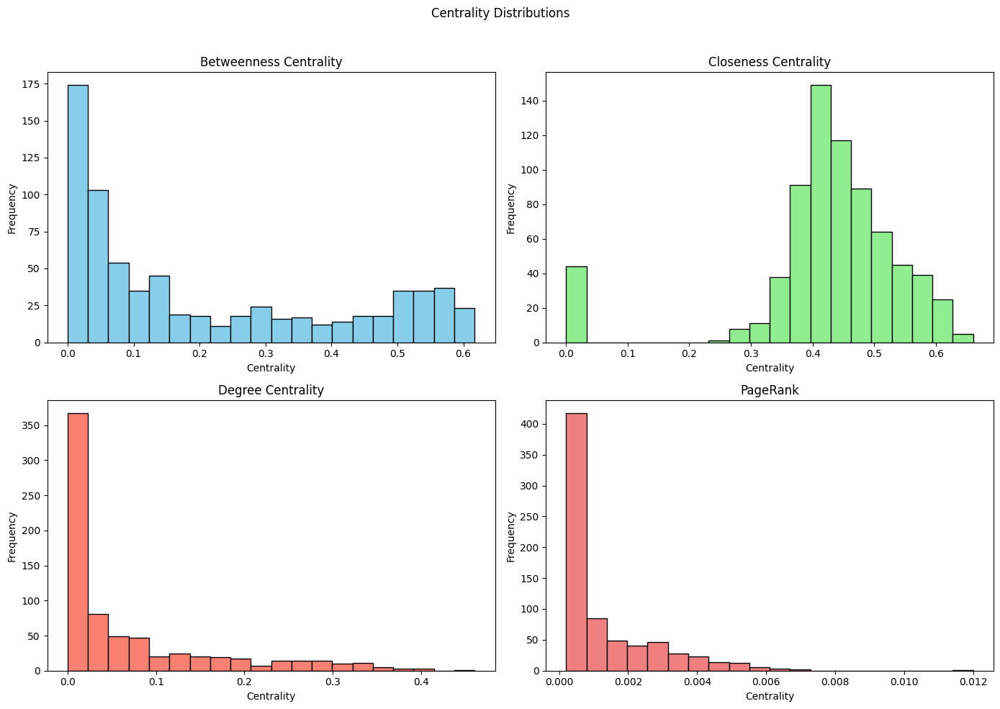

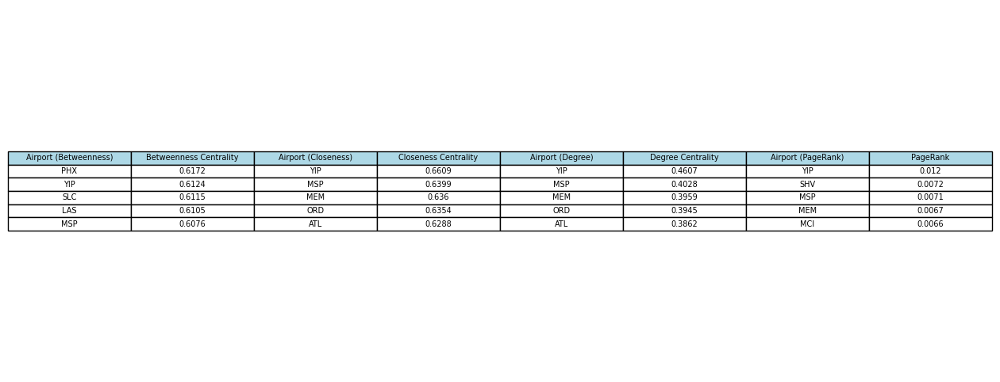

In [15]:
compare_centralities(graph)

## ***2.3***

In addition to the typical centrality measures like **Degree**, **Closeness**, **Betweenness**, and **PageRank**, several other centrality measures could be relevant for this directed graph. These measures can provide different perspectives on node importance in a directed graph, and might help uncover insights missed by the standard measures.

Here are three alternative centrality measures that might be useful:

#### a) **Eigenvector Centrality**
   - **Definition**: Eigenvector centrality assigns a score to each node based on the principle that connections to high-scoring nodes contribute more to the score of the node in question. It is based on the eigenvector of the graph's adjacency matrix.
   - **How it's calculated**: The calculation involves solving the equation $( A \cdot v = \lambda \cdot v )$, where $A$ is the adjacency matrix, $v$ is the vector of centrality scores, and $\lambda$ is a constant (the eigenvalue). This is solved iteratively using power iteration methods.

   - **Insight**: This measure captures the influence of a node in terms of the influence of its neighbors. It can identify nodes that are connected to other important nodes, even if their direct degree is not high.

#### b) **Katz Centrality**
   - **Definition**: Katz centrality is a variation of eigenvector centrality but includes a decay factor that limits the influence of distant nodes. It calculates centrality as the sum of direct and indirect neighbors' influence, weighted by a decay factor $\beta$.
   - **How it's calculated**: Katz centrality for each node is computed by solving the equation $x = \alpha \cdot A \cdot x + b$, where $A$ is the adjacency matrix, $\alpha$ is a scaling factor, and $b$ is a vector representing direct node influences.

   - **Insight**: Katz centrality identifies nodes that are influential but gives diminishing importance to nodes that are further away, making it suitable for networks where short paths are more relevant than long ones.

#### c) **HITS (Hyperlink-Induced Topic Search)**
   - **Definition**: The HITS algorithm computes two scores for each node: **authority** and **hub**. Hubs are nodes that point to many authorities, and authorities are nodes that are pointed to by many hubs. This method is useful for identifying nodes with strong authority or strong hub-like connections.
   - **How it's calculated**: The algorithm runs iteratively:
     1. Compute the authority score by summing the hub scores of the nodes pointing to the current node.
     2. Compute the hub score by summing the authority scores of the nodes that the current node points to.
     The process is repeated until the scores converge.

   - **Insight**: This measure is especially useful in analyzing networks like web pages, where certain nodes may act as "authorities" or "hubs."


## ***2.4***

### HITS Algorithm - Explanation and Insights

The **HITS (Hyperlink-Induced Topic Search)** algorithm provides two new measures: **Authority** and **Hub**. These measures can be useful for identifying nodes with strong indirect influence and for better understanding network dynamics, especially in graphs with a strong hierarchy or reference structure. 

- **Authority**: Nodes that are considered authoritative are often those that receive a large number of incoming connections from hubs.
- **Hub**: Hubs are nodes that have many outgoing connections, pointing to authoritative nodes.

Compared to other centrality measures, **HITS** may offer new perspectives, especially in directed graphs where the relationship between nodes is not symmetric. For instance:
- **Authority**: A node with a high **Authority** score but a low **Degree** or **Closeness** score might be a node with a strong indirect influence, recognized as an authoritative source by other nodes but not necessarily close to other nodes.
- **Hub**: A node with a high **Hub** score but low **Betweenness** might be a node that acts as a bridge between groups of nodes, without being particularly influential in terms of information flow.

Therefore, **HITS** could provide insights into the structure of networks, particularly in directed graphs, where it helps identify nodes that might not be the most connected but still play crucial roles in the overall network dynamics.


In [10]:
from functions import compute_hits
from functions import compute_degree
from functions import compute_betweenness
from functions import top_5_authority_low_degree
from functions import top_5_hub_low_betweenness

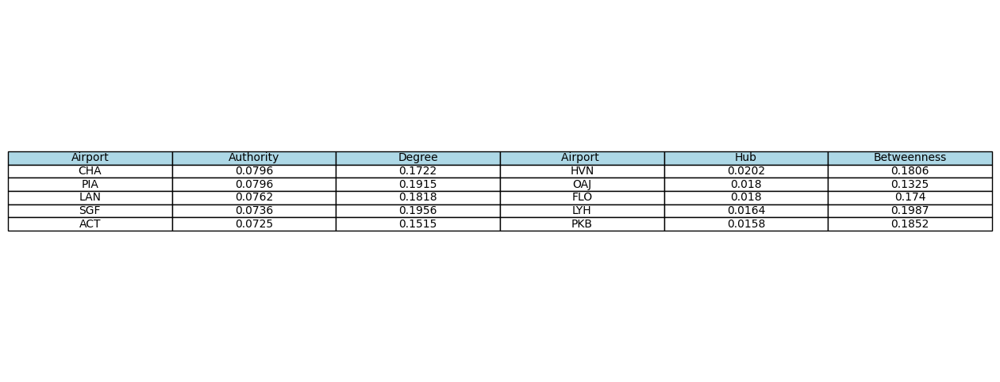

In [11]:
authority, hub = compute_hits(graph)  
degree = compute_degree(graph)  
betweenness = compute_betweenness(graph)

# Find top 5 airports with high authority and low degree
top_5_authority_low_degree_results = top_5_authority_low_degree(graph, authority, degree)

# Find top 5 airports with high hub and low betweenness
top_5_hub_low_betweenness_results = top_5_hub_low_betweenness(graph, hub, betweenness)


# Convert results into pandas DataFrames
df_authority_degree = pd.DataFrame(top_5_authority_low_degree_results)
df_hub_betweenness = pd.DataFrame(top_5_hub_low_betweenness_results)

# Combine the two DataFrames into one, matching airports from both lists
df_combined = pd.DataFrame()

# Adding authority and degree from the first list
df_combined['Airport'] = df_authority_degree['Airport']
df_combined['Authority'] = df_authority_degree['Authority']
df_combined['Degree'] = df_authority_degree['Degree']

# Adding hub and betweenness from the second list (notice extra space in column name)
df_combined['Airport '] = df_hub_betweenness['Airport']
df_combined['Hub'] = df_hub_betweenness['Hub']
df_combined['Betweenness'] = df_hub_betweenness['Betweenness']


# Visualize the table using Matplotlib
fig, ax = plt.subplots(figsize=(16, 6))
ax.axis('tight')
ax.axis('off')
ax.table(cellText=df_combined.values, colLabels=df_combined.columns, loc='center', cellLoc='center', colColours=['lightblue']*df.shape[1])

plt.show()

* **Top 5 Airports with High Authority and Low Degree**:
 - **What it means**: Airports with **high authority and low degree** are those that, despite not having many direct connections to other airports (low *degree*), are still considered very important in the network because they receive many connections (high *authority*). These airports are "arrival nodes" or central destinations for other airports, but they are not necessarily very well-connected directly.

    - **Example**: A major international airport that receives many flights from all over the USA (high *authority*), but has few direct flights to other airports (low *degree*).

* **Top 5 Airports with High Hub and Low Betweenness**:
 - **What it means**: Airports with **high hub and low betweenness** are those with many outgoing connections (high *hub*), but are not critical in connecting other airports to each other (low *betweenness*). In other words, these airports are important as starting points for flights to other destinations, but they are not key for the flow of flights between other airports.

    - **Example**: An airport that has many departing flights to different destinations (high *hub*), but is not a key airport for connecting or bridging flights between other airports (low *betweenness*). It is a popular starting point but not an "essential passage" for flights between other airports.

Both of these results provide insights into different aspects of the graph's structure.


# ***[Q3] Finding Best Routes:***

In [8]:
from functions import find_origin_cities_by_name
from functions import find_destination_cities_by_name
from functions import find_best_routes

In [9]:
dates = "1990-11-01"
origin = "New York"
destination = "Los Angeles"

In [10]:
routes_df = find_best_routes(graph, find_origin_cities_by_name(origin, df), find_destination_cities_by_name(destination, df), dates)
routes_df

,Origin_city_airport,Destination_city_airport,Best_route
0,JFK,LAX,JFK → LAX
1,LGA,LAX,LGA → EWR → LAX
2,JRA,LAX,No route found.
3,JRB,LAX,No route found.
4,TSS,LAX,No route found.
5,WTC,LAX,No route found.


Iterative map that show the various paths

In [11]:
from functions import create_usa_airports_map
from functions import add_routes_to_map

In [12]:
# Create a map of US airports
map = create_usa_airports_map(df)
map.save('usa_airports_map.html')  # Save the map as HTML file

# Add best routes to the existing map
usa_map_with_routes = add_routes_to_map(map, routes_df, df)

# Save the updated map with routes
usa_map_with_routes.save('usa_airports_map_with_routes.html')

In [13]:
usa_map_with_routes

**if you encounter problems viewing the map, please refer to the file usa_airports_map_with_routes.png and usa_airports_map_with_routes.html**

# ***[Q4] Airline Network Partitioning:***

Imagine all these flights are currently managed by a single airline. However, this airline is facing bankruptcy and plans to transfer the management of part of its operations to a different airline. The airline is willing to divide the flight network into two distinct partitions, p_1 and p_2, such that no flights connect any airport in p_1 to any airport in p_2. The flights in p_1 will remain under the management of the original airline, while those in p_2 will be handed over to the second airline. Any remaining flights needed to connect these two partitions will be determined later.

- In graph theory, this task is known as a graph disconnection problem. Your goal is to write a function that removes the minimum number of flights between airports to separate the original flight network into two disconnected subgraphs.

The function takes the following inputs:

1. Flight network

The function outputs:

1. The flights removed to disconnect the graph.
2. Visualize the original flight network.
3. Visualize the graph after removing the connections and highlight the two resulting subgraphs.

# ***WITH NOT WEIGHTED GRAPH***

Firstly, we're going to try to resolve the graph disconnection problem using a not weighted graph.

In [23]:
# function to create a graph from the flight network data (this time is a not weighted graph)
def build_graph(flight_network):
    graph = {}
    
    for _, row in flight_network.iterrows():
        origin = row['Origin_airport']
        destination = row['Destination_airport']
        
        # Add edges to the graph
        if origin not in graph:
            graph[origin] = set()
        if destination not in graph:
            graph[destination] = set()
        
        graph[origin].add(destination)
        graph[destination].add(origin)
    
    return graph


In [24]:
G = build_graph(df3)

To resolve the graph disconnection problem for a not weighted graph (G) we have to follow this steps:

- create and use the function "bfs" (Breadth-First Search) which performs a Breadth-First Search on a graph, starting from a source node ("source") and attempting to reach a target node ("sink"). It is used to check if there's a path between "source" and "sink" in the residual graph, which is required to calculate the maximum flow.
- create and use the "min_cut" function where we'll implement the "Ford-Fulkerson" algorithm to calculate the maximum flow between "source" and "sink". It identifies the edges that, if removed, split the graph into two connected components (the minimum cut)
- create a "select_source_and_sink" function to identify the best "source" and "sink"


In [25]:
from collections import deque

def bfs(graph, source, sink, parent):
    visited = {node: False for node in graph}
    queue = deque([source])
    visited[source] = True

    while queue:
        node = queue.popleft()
        for neighbor in graph[node]:
            if not visited[neighbor]:
                queue.append(neighbor)
                visited[neighbor] = True
                parent[neighbor] = node
                if neighbor == sink:
                    return True
    return False

def min_cut(graph, source, sink):
    parent = {}
    residual_graph = {u: set(v) for u, v in graph.items()}
    
    # Ford-Fulkerson for maximum flow
    while bfs(residual_graph, source, sink, parent):
        v = sink
        while v != source:
            u = parent[v]
            residual_graph[u].remove(v)
            residual_graph[v].add(u)  # Reverse edge
            v = u
    
    # Find the nodes reachable from the source
    visited = set()
    queue = deque([source])
    while queue:
        node = queue.popleft()
        visited.add(node)
        for neighbor in residual_graph[node]:
            if neighbor not in visited:
                queue.append(neighbor)
    
    # Edge which connect visited to non-visited
    cut_edges = []
    for u in visited:
        for v in graph[u]:
            if v not in visited:
                cut_edges.append((u, v))
    
    return cut_edges


In [26]:
def select_source_and_sink(flight_network):
    # Calculate total degree (in-degree + out-degree) for each airport
    degrees = {}
    for _, row in flight_network.iterrows():
        origin = row['Origin_airport']
        destination = row['Destination_airport']
        
        degrees[origin] = degrees.get(origin, 0) + 1
        degrees[destination] = degrees.get(destination, 0) + 1
    
    # sort airports by their degrees
    sorted_degrees = sorted(degrees.items(), key=lambda x: x[1], reverse=True)
    
    # take the two nodes with highest degree as source e sink
    source = sorted_degrees[0][0]  # Nodo con il grado massimo
    sink = sorted_degrees[1][0]    # Nodo con il secondo grado massimo
    
    return source, sink


In [27]:
source, sink = select_source_and_sink(df3)

In [28]:
source, sink

('ORD', 'ATL')

In [29]:
# Step 3: Find minimum cut
cut_edges = min_cut(G, source, sink)
    
# Step 4: visalize removed edges to disconnect the graph
print("Removed edges to disconnect the graph:", cut_edges)

Removed edges to disconnect the graph: [('ORD', 'EWR'), ('ORD', 'AVP'), ('ORD', 'ALO'), ('ORD', 'SAN'), ('ORD', 'LAW'), ('ORD', 'SGF'), ('ORD', 'ILN'), ('ORD', 'OAJ'), ('ORD', 'GYY'), ('ORD', 'LSE'), ('ORD', 'BHM'), ('ORD', 'FSM'), ('ORD', 'MKG'), ('ORD', 'BAD'), ('ORD', 'FAT'), ('ORD', 'YIP'), ('ORD', 'ERI'), ('ORD', 'LUK'), ('ORD', 'BZN'), ('ORD', 'EDF'), ('ORD', 'NQX'), ('ORD', 'AZO'), ('ORD', 'GFK'), ('ORD', 'JNU'), ('ORD', 'FTW'), ('ORD', 'GEG'), ('ORD', 'HIF'), ('ORD', 'HSV'), ('ORD', 'MKE'), ('ORD', 'SBY'), ('ORD', 'PIH'), ('ORD', 'SAF'), ('ORD', 'ISO'), ('ORD', 'SUS'), ('ORD', 'EVV'), ('ORD', 'CKB'), ('ORD', 'MGM'), ('ORD', 'LBF'), ('ORD', 'PDT'), ('ORD', 'CWA'), ('ORD', 'LFT'), ('ORD', 'CRW'), ('ORD', 'JAN'), ('ORD', 'AFW'), ('ORD', 'RAP'), ('ORD', 'CSG'), ('ORD', 'FCA'), ('ORD', 'CMI'), ('ORD', 'LNK'), ('ORD', 'PIB'), ('ORD', 'IAD'), ('ORD', 'ATW'), ('ORD', 'BIL'), ('ORD', 'FAY'), ('ORD', 'OAK'), ('ORD', 'MKL'), ('ORD', 'ALB'), ('ORD', 'PVD'), ('ORD', 'NKX'), ('ORD', 'CYS'), 

Now, let's visualize the graphs before and after the disconnection

In [30]:
import networkx as nx
import matplotlib.pyplot as plt

def visualize_graph(graph, removed_edges=None, title="Flight Network"):
    G = nx.Graph()
    for node, neighbors in graph.items():
        for neighbor in neighbors:
            G.add_edge(node, neighbor)
    
    if removed_edges:
        G.remove_edges_from(removed_edges)
    
    plt.figure(figsize=(12, 8))
    nx.draw(G, with_labels=True, node_color='skyblue', edge_color='gray', node_size=500, font_size=8)
    plt.title(title)
    plt.show()


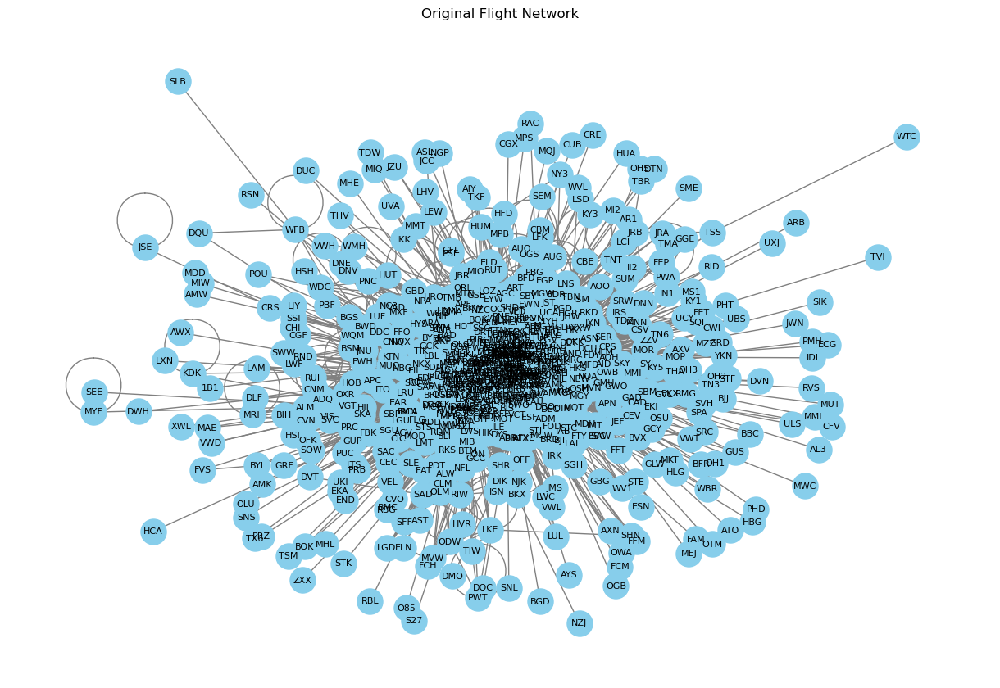

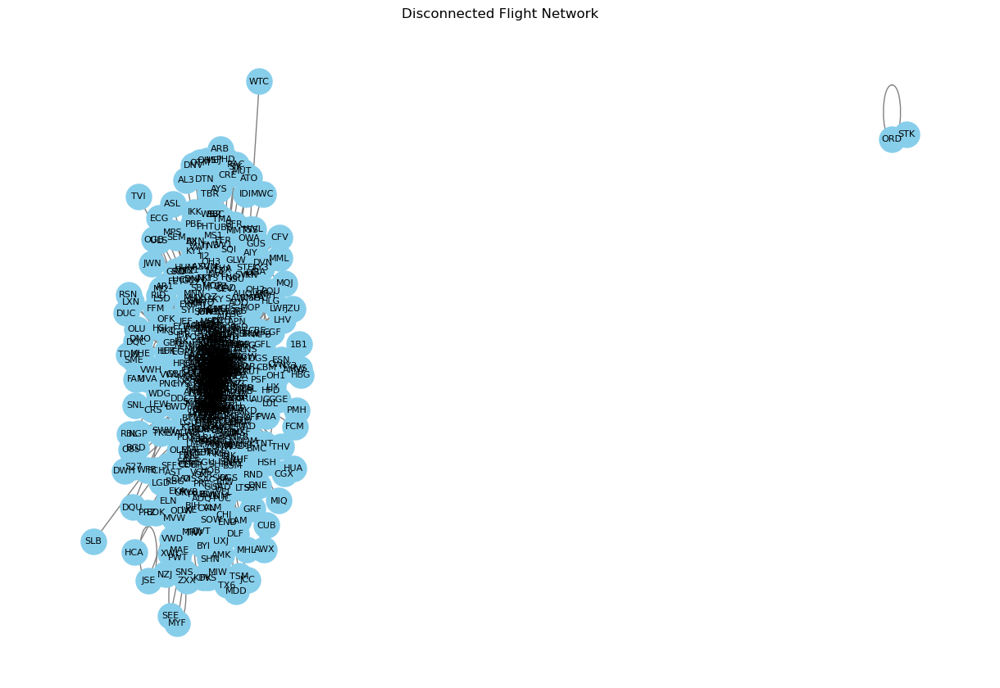

In [31]:
visualize_graph(G, title="Original Flight Network")
visualize_graph(G, removed_edges=cut_edges, title="Disconnected Flight Network")

# ***TEST WEIGHTED GRAPH***

Now, we will try with a weighted graph

In [32]:
def build_weighted_graph(flight_network, weight_column='Passengers'):
    graph = {}
    for _, row in flight_network.iterrows():
        origin = row['Origin_airport']
        destination = row['Destination_airport']
        weight = row[weight_column]
        
        if weight > 0:  # Exclude edges with zero weight
            if origin not in graph:
                graph[origin] = {}
            if destination not in graph:
                graph[destination] = {}
            
            # Add the weighted edge
            graph[origin][destination] = weight
            graph[destination][origin] = weight  # non-directional graph
    
    return graph


In [33]:
GB = build_weighted_graph(df3)

To resolve the graph disconnection problem for a weighted graph (GB) we have to follow this steps (they're the same as before):

- create and use the function "bfs" (Breadth-First Search) which performs a Breadth-First Search on a graph, starting from a source node ("source") and attempting to reach a target node ("sink"). It is used to check if there's a path between "source" and "sink" in the residual graph, which is required to calculate the maximum flow.
- create and use the "min_cut" function where we'll implement the "Ford-Fulkerson" algorithm to calculate the maximum flow between "source" and "sink". It identifies the edges that, if removed, split the graph into two connected components (the minimum cut)
- create a "select_source_and_sink" function to identify the best "source" and "sink"

This time, differently from the first test with a not weighted graph, we will consider the feature "Passengers" as a weight feature and we will do some small changes in the function below to adapt the code for the current case.


In [34]:
from collections import deque

def bfs_capacity(graph, source, sink, parent):
    visited = {node: False for node in graph}
    queue = deque([source])
    visited[source] = True
    
    while queue:
        node = queue.popleft()
        for neighbor, capacity in graph[node].items():
            if not visited[neighbor] and capacity > 0:  # Consider only edges with positive capacity
                parent[neighbor] = node
                if neighbor == sink:
                    return True
                queue.append(neighbor)
                visited[neighbor] = True
    return False

def ford_fulkerson(graph, source, sink):
    parent = {}
    residual_graph = {u: dict(v) for u, v in graph.items()}
    max_flow = 0
    
    # Ford-Fulkerson with BFS
    while bfs_capacity(residual_graph, source, sink, parent):
        path_flow = float('Inf')
        v = sink
        while v != source:
            u = parent[v]
            path_flow = min(path_flow, residual_graph[u][v])
            v = u
        
        # Update residual graph
        v = sink
        while v != source:
            u = parent[v]
            residual_graph[u][v] -= path_flow
            residual_graph[v][u] += path_flow
            v = u
        
        max_flow += path_flow
    
    # Identify the minimum cut
    visited = set()
    queue = deque([source])
    while queue:
        node = queue.popleft()
        visited.add(node)
        for neighbor, capacity in residual_graph[node].items():
            if neighbor not in visited and capacity > 0:
                queue.append(neighbor)
    
    # Edges which forms the minimum cut
    min_cut_edges = []
    for u in visited:
        for v, capacity in graph[u].items():
            if v not in visited and capacity > 0:
                min_cut_edges.append((u, v, capacity))
    
    return max_flow, min_cut_edges


In [35]:
import networkx as nx
import matplotlib.pyplot as plt

def visualize_weighted_graph(graph, cut_edges=None, title="Weighted Flight Network"):
    G = nx.Graph()
    for node, neighbors in graph.items():
        for neighbor, weight in neighbors.items():
            G.add_edge(node, neighbor, weight=weight)
    
    # Remove the cut edges to visualize the disconnected graph
    if cut_edges:
        G.remove_edges_from([(u, v) for u, v, _ in cut_edges])
    
    pos = nx.spring_layout(G)
    edge_labels = {(u, v): f"{d['weight']:.0f}" for u, v, d in G.edges(data=True)}
    
    plt.figure(figsize=(12, 8))
    nx.draw(G, pos, with_labels=True, node_color='skyblue', edge_color='gray', node_size=500, font_size=8)
    nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)
    plt.title(title)
    plt.show()


In [36]:
def select_source_and_sink_weighted(graph):
    """
    Select automatically the source and sink based on the sum of edge weights.
    """
    node_weights = {node: sum(neighbors.values()) for node, neighbors in graph.items()}
    
    # Sort nodes by their weights
    sorted_nodes = sorted(node_weights.items(), key=lambda x: x[1], reverse=True)
    
    # Take the two nodes with the highest weights as source and sink
    source = sorted_nodes[0][0]
    sink = sorted_nodes[1][0]  # the second highest weight
    
    return source, sink


In [37]:
source, sink = select_source_and_sink_weighted(GB)
print(f"Source: {source}, Sink: {sink}")

Source: DFW, Sink: ATL


In [38]:
max_flow, min_cut_edges = ford_fulkerson(GB, source, sink)
print(f"Maximum Flow (Min-Cut Capacity): {max_flow}")
print(f"Removed edges to disconnect the graph (with weights): {min_cut_edges}")
    

Maximum Flow (Min-Cut Capacity): 604662
Removed edges to disconnect the graph (with weights): [('EWR', 'ATL', 19629), ('AVP', 'ATL', 1315), ('ALO', 'ATL', 124), ('SAN', 'ATL', 7156), ('GYY', 'ATL', 149), ('FSM', 'ATL', 551), ('LUK', 'BQK', 83), ('ERI', 'ATL', 2174), ('SAF', 'APF', 2), ('CKB', 'ATL', 123), ('EVV', 'ATL', 3322), ('FCA', 'ATL', 385), ('BIL', 'ATL', 1793), ('OAK', 'ATL', 50), ('MKL', 'ATL', 37), ('PVD', 'ATL', 7124), ('TCL', 'ATL', 138), ('CYS', 'ATL', 64), ('AUS', 'ATL', 18497), ('AUS', 'DHN', 70), ('AUS', 'APF', 21), ('COS', 'APF', 1), ('COS', 'ATL', 3832), ('TLH', 'ABY', 44), ('TLH', 'APF', 6), ('TLH', 'ATL', 5746), ('TLH', 'VLD', 40), ('TLH', 'DHN', 48), ('FNT', 'ATL', 2336), ('CNM', 'SSI', 12), ('LEX', 'ATL', 6174), ('IDA', 'ATL', 80), ('MWA', 'ATL', 51), ('ABI', 'ATL', 25), ('JFK', 'ATL', 7934), ('EAU', 'ATL', 110), ('PIA', 'ATL', 1717), ('NZY', 'ATL', 57), ('MDT', 'DHN', 151), ('MDT', 'ATL', 31), ('LRU', 'ATL', 135), ('BFI', 'ATL', 101), ('TPA', 'ATL', 10864), ('TPA

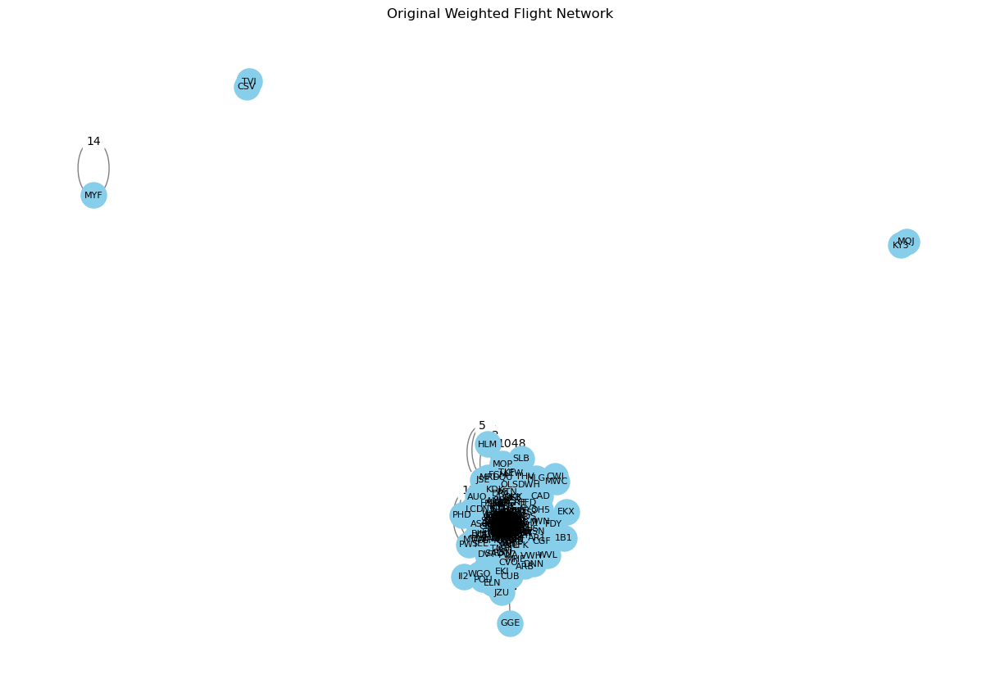

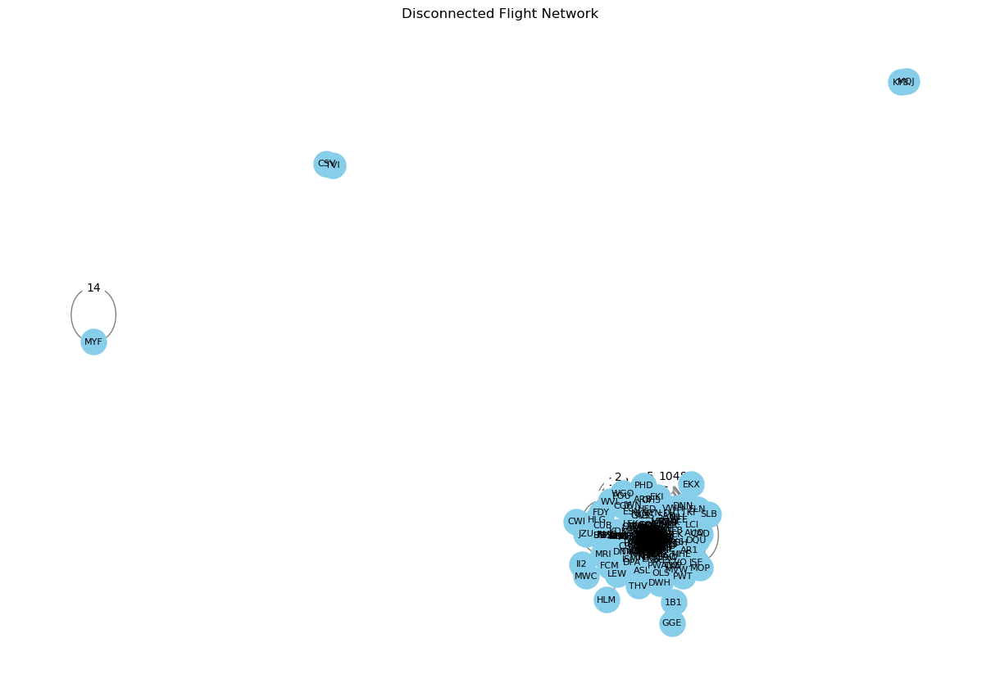

In [39]:
visualize_weighted_graph(GB, title="Original Weighted Flight Network")
visualize_weighted_graph(GB, cut_edges=min_cut_edges, title="Disconnected Flight Network")

# 5. Finding and Extracting Communities (Q5)

In [9]:
df.head()

,Origin_airport,Destination_airport,Origin_city,Destination_city,Passengers,Seats,Flights,Distance,Fly_date,Origin_population,Destination_population,Org_airport_lat,Org_airport_long,Dest_airport_lat,Dest_airport_long
0,MHK,AMW,"Manhattan, KS","Ames, IA",21,30,1,254,2008-10-01,122049,86219,39.140999,-96.670799,NaN,NaN
1,EUG,RDM,"Eugene, OR","Bend, OR",41,396,22,103,1990-11-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
2,EUG,RDM,"Eugene, OR","Bend, OR",88,342,19,103,1990-12-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
3,EUG,RDM,"Eugene, OR","Bend, OR",11,72,4,103,1990-10-01,284093,76034,44.124599,-123.211998,44.254101,-121.150002
4,MFR,RDM,"Medford, OR","Bend, OR",0,18,1,156,1990-02-01,147300,76034,42.374199,-122.873001,44.254101,-121.150002


In [10]:
df5 = df.copy()

In [11]:
df5 = preprocess_flight_data(df5)

In [12]:
df5 = df5[['Origin_city', 'Destination_city', 'Passengers']]

In [13]:
df5.head()

,Origin_city,Destination_city,Passengers
0,"Manhattan, KS","Ames, IA",21
1,"Eugene, OR","Bend, OR",41
9,"Seattle, WA","Bend, OR",8
14,"Portland, OR","Bend, OR",349
38,"Klamath Falls, OR","Bend, OR",139


In [41]:
df5.info()

<class 'pandas.core.frame.DataFrame'>
Index: 24769 entries, 0 to 3606801
Data columns (total 3 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   Origin_city       24769 non-null  object
 1   Destination_city  24769 non-null  object
 2   Passengers        24769 non-null  int64 
dtypes: int64(1), object(2)
memory usage: 774.0+ KB


### Phase 1: Initialization and Node Assignment

In this phase, we initialize the tracker to assign nodes to communities and compute initial statistics for each node and community.

This function initializes the tracker that keeps track of which community each node belongs to, the degree of each node (the sum of weights of edges incident to a node), self-loops (edges that start and end at the same node), and community statistics. Every node starts in its own community in this phase.


In [ ]:
import networkx as nx
import matplotlib.pyplot as plt
from collections import defaultdict
import random

# Initialize community tracker
def initialize_tracker(G):

    tracker = {
        'node_to_community': {},
        'total_weight': G.size(weight="weight"),
        'degrees': {},
        'self_loops': {},
        'community_degrees': defaultdict(float),
        'community_self_loops': defaultdict(float)
    }

    for node in G:
        tracker['node_to_community'][node] = node  # Each node starts in its own community
        degree = G.degree(node, weight="weight")
        tracker['degrees'][node] = degree
        tracker['community_degrees'][node] = degree
        tracker['self_loops'][node] = G[node].get(node, {}).get('weight', 0)  # Self-loops
    
    return tracker

### Phase 2: Modularity Optimization (Community Movement)
In this phase, the algorithm iterates over nodes and attempts to improve community assignment by moving nodes between communities to maximize modularity.

#### Move Node Function

This function moves a node from its current community (`old_community`) to a new community (`new_community`) and updates community statistics, such as total degree and self-loops for both communities.


In [92]:
# Move node to a new community and update stats
def move_node(tracker, node, old_community, new_community, incident_weight):

    tracker['community_degrees'][old_community] -= tracker['degrees'][node]
    tracker['community_self_loops'][old_community] -= incident_weight + tracker['self_loops'][node]
    
    tracker['community_degrees'][new_community] += tracker['degrees'][node]
    tracker['community_self_loops'][new_community] += incident_weight + tracker['self_loops'][node]
    
    tracker['node_to_community'][node] = new_community


#### Get Neighboring Communities Function

This function computes the communities that are neighbors to a given node. It sums up the edge weights between the node and its neighbors to determine the strength of the connections between the node and the neighboring communities.


In [ ]:
# Get neighboring communities of a node
def get_neighboring_communities(G, tracker, node):

    neighbor_communities = defaultdict(float)
    for neighbor in G[node]:
        community = tracker['node_to_community'][neighbor]
        edge_weight = G[node][neighbor].get("weight", 1)
        neighbor_communities[community] += edge_weight
    return neighbor_communities

### Calculate Modularity Change Function

This function calculates the change in modularity when a node is moved from its current community to a new one. The modularity change is based on the total degree of the community, the degree of the node, and the weight of the incident edges between the node and the community.


In [ ]:
# Calculate modularity change when moving a node to new community
def calculate_modularity_change(tracker, node, community, incident_weight):

    total_community_degree = tracker['community_degrees'][community]
    node_degree = tracker['degrees'][node]
    modularity_change = (2 * incident_weight) - ((total_community_degree * node_degree) / tracker['total_weight'])
    return modularity_change


### Create a Coarse-Grained Graph Function

This function generates a new coarse-grained graph where each node represents a community. It creates a new graph by:

1. Adding nodes for each unique community.
2. Iterating over the edges of the original graph and updating the new graph to represent edges between communities.
3. The edge weight between two communities is the sum of the weights of edges connecting nodes in those communities.

The resulting coarse-grained graph captures the community-level structure of the original graph.


In [ ]:
# Generate a new coarse-grained graph where each node represents a community
def create_coarse_grained_graph(G, community_map):

    new_graph = nx.Graph()
    for community in set(community_map.values()):
        new_graph.add_node(community)
    
    for u, v, weight in G.edges(data="weight", default=1):
        community_u = community_map[u]
        community_v = community_map[v]
        if new_graph.has_edge(community_u, community_v):
            new_graph[community_u][community_v]['weight'] += weight
        else:
            new_graph.add_edge(community_u, community_v, weight=weight)
    
    return new_graph



### Louvain Algorithm Function

This function implements the main loop of the Louvain algorithm for community detection. The process works as follows:

1. **Node Movement for Modularity Optimization**: The algorithm iteratively moves nodes to neighboring communities that result in an increase in modularity. This helps to find the best possible community structure that maximizes modularity.

2. **Graph Coarsening**: After each iteration of node movements, the graph is progressively coarsened. This means that nodes are grouped into communities, and edges are merged, which speeds up the algorithm and allows for more efficient community detection.

The algorithm continues this process until no further improvements in modularity can be made, resulting in a final community structure.


In [ ]:
# Louvain method for community detection
def run_louvain(G, verbose=False, randomized=False):

    tracker = initialize_tracker(G)
    community_history = []
    finished = False
    community_map = {}
    communities = []

    iteration_count = 0
    while not finished:
        iteration_count += 1
        improved = True
        while improved:
            improved = False
            nodes = list(G.nodes())
            if randomized:
                random.shuffle(nodes)
            
            for node in nodes:
                best_modularity_increase = 0.0
                current_community = tracker['node_to_community'][node]
                best_community = current_community
                neighbor_communities = get_neighboring_communities(G, tracker, node)
                
                old_incident_weight = neighbor_communities.get(current_community, 0)
                for community, incident_weight in neighbor_communities.items():
                    delta_Q = calculate_modularity_change(tracker, node, community, incident_weight)
                    if delta_Q > best_modularity_increase:
                        best_modularity_increase = delta_Q
                        best_community = community
                
                if best_community != current_community:
                    move_node(tracker, node, current_community, best_community, old_incident_weight)
                    improved = True

        if improved:
            community_history.append(tracker['node_to_community'])
            G = create_coarse_grained_graph(G, tracker['node_to_community'])
        else:
            finished = True

    community_map = tracker['node_to_community']
    communities = invert_community_map(community_map)
    if verbose:
        print(f"Community detection finished in {iteration_count} iterations.")
    
    return communities, community_map


The `invert_community_map` function takes a community map, which is a dictionary where each node is associated with a community, and inverts it to group nodes by their respective communities.

In [ ]:
# Invert community map to group nodes by communities
def invert_community_map(community_map):

    inverted_map = defaultdict(list)
    for node, community in community_map.items():
        inverted_map[community].append(node)
    return list(inverted_map.values())



In [ ]:
# Visualize the detected communities in the graph
def visualize_communities(G, communities, title):

    community_colors = {node: community for community, nodes in enumerate(communities) for node in nodes}
    pos = nx.spring_layout(G)
    plt.figure(figsize=(10, 8))
    nx.draw_networkx_nodes(G, pos, node_color=[community_colors[node] for node in G.nodes()])
    nx.draw_networkx_edges(G, pos, alpha=0.5)
    nx.draw_networkx_labels(G, pos, font_size=12)
    plt.title(title)
    plt.show()


In [ ]:
# Function to check if two cities belong to the same community
def are_cities_in_communities(city1, city2, communities):

    for community in communities:
        if city1 in community and city2 in community:
            return True
    return False

In [ ]:
# Sample dataframe including the cities we are interested in
def analyze_flight_network(df, city1, city2, sample_size=300):
    
    # Validate input DataFrame
    required_columns = {'Origin_city', 'Destination_city', 'Passengers'}
    if not required_columns.issubset(df.columns):
        raise ValueError(f"Input DataFrame must contain the following columns: {required_columns}")

    # Filter for the two cities and limit the sample size
    cities_to_include = [city1, city2]
    sample_df = df[df['Origin_city'].isin(cities_to_include) | df['Destination_city'].isin(cities_to_include)]
    if sample_df.empty:
        raise ValueError(f"No flight data found for the cities: {city1} and {city2}")

    if len(sample_df) > sample_size:
        sample_df = sample_df.sample(sample_size)

    return sample_df  

Community detection finished in 1 iterations.
Juneau, AK and Anchorage, AK are in the same community: False
Total communities found: 2
Community 1: ['Anchorage, AK', 'Rochester, MN', 'Bangor, ME', 'Spokane, WA', 'Kodiak, AK', 'Aberdeen, SD', 'Honolulu, HI', 'Fairbanks, AK', 'Kahului, HI', 'Detroit, MI', 'Salt Lake City, UT', 'Idaho Falls, ID', 'Rockford, IL', 'Houston, TX', 'Grand Junction, CO', 'Buffalo, NY', 'La Crosse, WI', 'Las Vegas, NV', 'Phoenix, AZ', 'Fargo, ND', 'Cleveland, OH', 'Montgomery, AL', 'New York, NY', 'Reno, NV']
Community 2: ['Seattle, WA', 'Juneau, AK', 'Chicago, IL', 'Portland, OR', 'Ketchikan, AK', 'Minneapolis, MN', 'Los Angeles, CA']


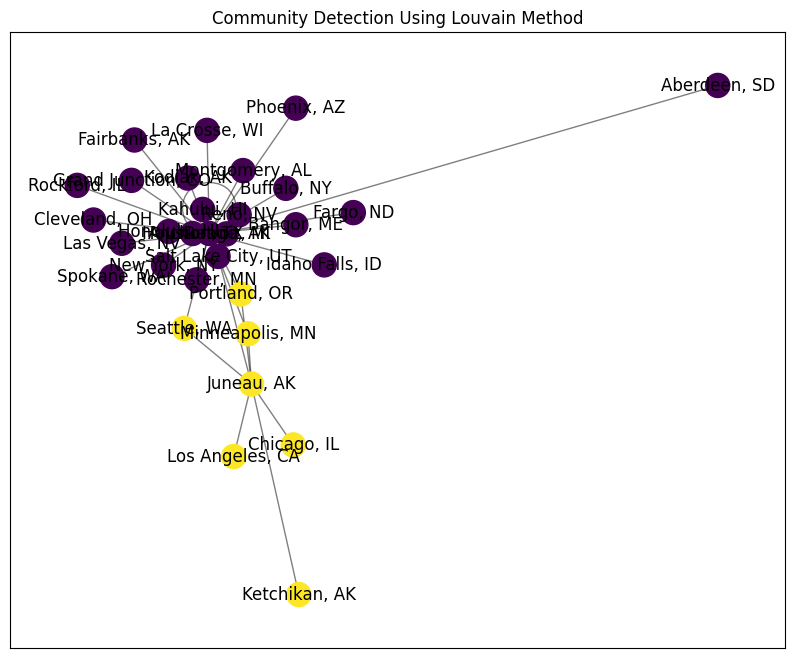

In [80]:
# Run analysis based on the sample
def run_analysis_on_sample(sample_df, city1, city2):
    
    # Build the graph
    G = nx.Graph()
    for _, row in sample_df.iterrows():
        G.add_edge(row['Origin_city'], row['Destination_city'], weight=row['Passengers'])

    # Run Louvain community detection
    communities, community_map = run_louvain(G, verbose=True)

    # Check if the cities are in the same community
    same_community = are_cities_in_communities(city1, city2, communities)
    print(f"{city1} and {city2} are in the same community: {same_community}")

    # Display community information
    print(f"Total communities found: {len(communities)}")
    for idx, community in enumerate(communities):
        print(f"Community {idx + 1}: {community}")

    # Visualize the graph with communities
    visualize_communities(G, communities, "Community Detection Using Louvain Method")


# Get the sample data
sample_df = analyze_flight_network(df5, 'Juneau, AK', 'Anchorage, AK', sample_size=50)

# Run the analysis with the sample data
run_analysis_on_sample(sample_df, 'Juneau, AK', 'Anchorage, AK')


Analysis of the sampled dataframe

In [95]:
import networkx as nx

# Create the graph from sample_df
G = nx.Graph()
for _, row in sample_df.iterrows():
    G.add_edge(row['Origin_city'], row['Destination_city'], weight=row['Passengers'])

# Number of nodes and edges
num_nodes = G.number_of_nodes()
num_edges = G.number_of_edges()

# Maximum possible edges in an undirected graph (for a graph with N nodes)
max_possible_edges = num_nodes * (num_nodes - 1) / 2

# Sparsity calculation
sparsity = 1 - (num_edges / max_possible_edges)

# Print sparsity
print(f"Sparsity of the graph: {sparsity:.4f}")


Sparsity of the graph: 0.9269


Run Louvain community detection method over the sampeld dataframe

Community detection finished in 1 iterations.
Juneau, AK and Anchorage, AK are in the same community: False
Total communities found: 2
Community 1: ['Anchorage, AK', 'Rochester, MN', 'Bangor, ME', 'Spokane, WA', 'Kodiak, AK', 'Aberdeen, SD', 'Honolulu, HI', 'Fairbanks, AK', 'Kahului, HI', 'Detroit, MI', 'Salt Lake City, UT', 'Idaho Falls, ID', 'Rockford, IL', 'Houston, TX', 'Grand Junction, CO', 'Buffalo, NY', 'La Crosse, WI', 'Las Vegas, NV', 'Phoenix, AZ', 'Fargo, ND', 'Cleveland, OH', 'Montgomery, AL', 'New York, NY', 'Reno, NV']
Community 2: ['Seattle, WA', 'Juneau, AK', 'Chicago, IL', 'Portland, OR', 'Ketchikan, AK', 'Minneapolis, MN', 'Los Angeles, CA']


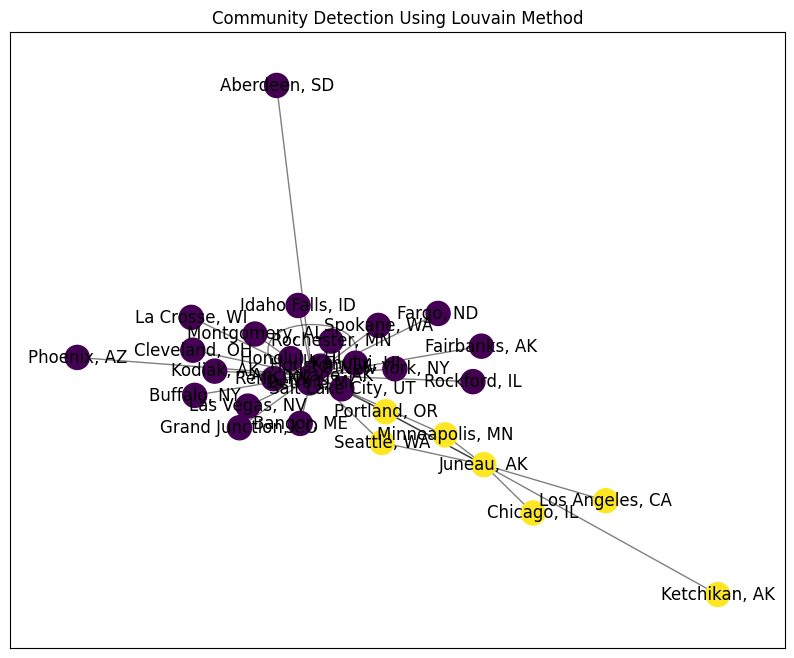

In [81]:
run_analysis_on_sample(sample_df, 'Juneau, AK', 'Anchorage, AK')

Community detection finished in 1 iterations.
Seattle, WA and Juneau, AK are in the same community: True
Total communities found: 2
Community 1: ['Anchorage, AK', 'Rochester, MN', 'Bangor, ME', 'Spokane, WA', 'Kodiak, AK', 'Aberdeen, SD', 'Honolulu, HI', 'Fairbanks, AK', 'Kahului, HI', 'Detroit, MI', 'Salt Lake City, UT', 'Idaho Falls, ID', 'Rockford, IL', 'Houston, TX', 'Grand Junction, CO', 'Buffalo, NY', 'La Crosse, WI', 'Las Vegas, NV', 'Phoenix, AZ', 'Fargo, ND', 'Cleveland, OH', 'Montgomery, AL', 'New York, NY', 'Reno, NV']
Community 2: ['Seattle, WA', 'Juneau, AK', 'Chicago, IL', 'Portland, OR', 'Ketchikan, AK', 'Minneapolis, MN', 'Los Angeles, CA']


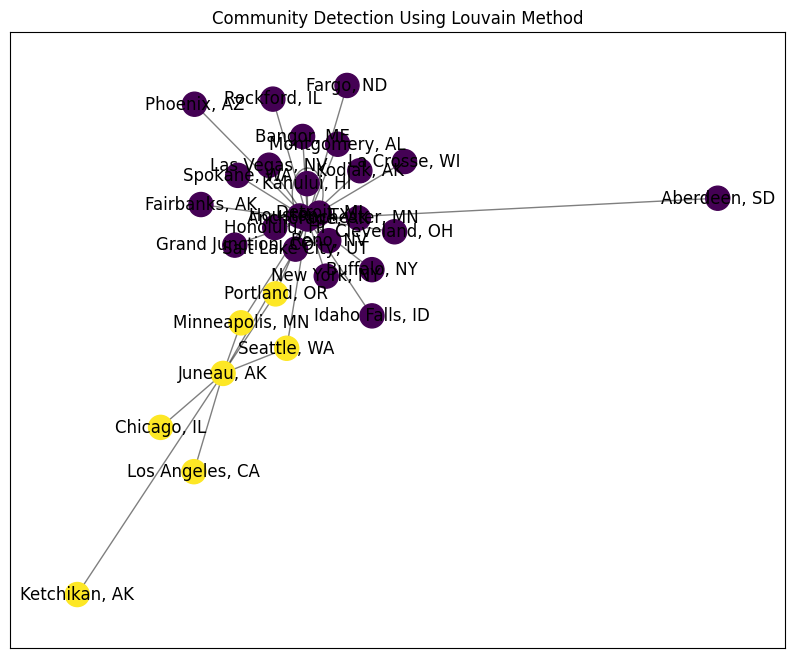

In [85]:
run_analysis_on_sample(sample_df, 'Seattle, WA', 'Juneau, AK')

### Alternative Algorithm: Girvan-Newman Algorithm

### Steps to Implement the Girvan-Newman Algorithm:

1. **Calculate Betweenness Centrality**:
   - Betweenness centrality measures the number of shortest paths that pass through a given edge. 
   - Higher betweenness centrality indicates that an edge is a critical connector between different parts of the graph.

2. **Remove Edge with Highest Betweenness Centrality**:
   - After calculating the betweenness centrality for all edges, the edge with the highest betweenness centrality is removed from the graph.

3. **Repeat**:
   - The process is repeated (recalculating betweenness centrality after each edge removal) until the graph breaks into multiple connected components.
   - Each connected component after the removal of these edges is considered a community.

4. **Stopping Condition**:
   - The algorithm stops when the graph has been split into isolated components, and these components are the detected communities.


In [87]:
import networkx as nx

def girvan_newman(G):
    """
    Implements the Girvan-Newman algorithm for community detection.
    Args:
    - G: A NetworkX graph object.
    
    Returns:
    - A list of communities, where each community is a list of nodes.
    """
    # Create a copy of the graph to avoid modifying the original graph
    G_copy = G.copy()
    communities = []
    
    # Keep removing edges until the graph breaks into connected components
    while len(list(nx.connected_components(G_copy))) == 1:  # While the graph is still connected
        # Calculate betweenness centrality for edges
        edge_betweenness = nx.edge_betweenness_centrality(G_copy)
        
        # Find the edge with the highest betweenness centrality
        edge_to_remove = max(edge_betweenness, key=edge_betweenness.get)
        
        # Remove the edge from the graph
        G_copy.remove_edge(*edge_to_remove)
    
    # After removal, the graph breaks into connected components (communities)
    for component in nx.connected_components(G_copy):
        communities.append(list(component))
    
    return communities

# Use the same sampled dataframe
G = nx.Graph()
for _, row in sample_df.iterrows():
    G.add_edge(row['Origin_city'], row['Destination_city'], weight=row['Passengers'])

communities_gn = girvan_newman(G)
print("Detected Communities using Girvan-Newman:", communities_gn)


Detected Communities using Girvan-Newman: [['Reno, NV', 'Rochester, MN', 'Cleveland, OH', 'Houston, TX', 'Fairbanks, AK', 'Aberdeen, SD', 'Buffalo, NY', 'Spokane, WA', 'Rockford, IL', 'Las Vegas, NV', 'Grand Junction, CO', 'Phoenix, AZ', 'Kahului, HI', 'Idaho Falls, ID', 'Honolulu, HI', 'La Crosse, WI', 'Fargo, ND', 'Kodiak, AK', 'Montgomery, AL', 'Anchorage, AK', 'New York, NY', 'Bangor, ME', 'Detroit, MI'], ['Minneapolis, MN', 'Seattle, WA', 'Ketchikan, AK', 'Salt Lake City, UT', 'Portland, OR', 'Los Angeles, CA', 'Juneau, AK', 'Chicago, IL']]


### Comparison

In [89]:
G = nx.Graph()
for _, row in sample_df.iterrows():
    G.add_edge(row['Origin_city'], row['Destination_city'], weight=row['Passengers'])

# Running Louvain method
communities_louvain, community_map_louvain = run_louvain(G, verbose=True, randomized=True)
print("Detected Communities using Louvain:", communities_louvain)

# Running Girvan-Newman algorithm
communities_gn = girvan_newman(G)
print("Detected Communities using Girvan-Newman:", communities_gn)

# Function to calculate Jaccard Similarity between two sets of communities
def jaccard_similarity(set1, set2):
    intersection = len(set1.intersection(set2))
    union = len(set1.union(set2))
    return intersection / union if union != 0 else 0

# Compare communities
jaccard_similarities = []
for community_louvain in communities_louvain:
    for community_gn in communities_gn:
        jaccard_similarities.append(jaccard_similarity(set(community_louvain), set(community_gn)))

# Calculate the average Jaccard similarity
avg_jaccard_similarity = sum(jaccard_similarities) / len(jaccard_similarities)
print(f"Average Jaccard Similarity: {avg_jaccard_similarity}")



Community detection finished in 1 iterations.
Detected Communities using Louvain: [['Anchorage, AK', 'Rochester, MN', 'Bangor, ME', 'Spokane, WA', 'Kodiak, AK', 'Aberdeen, SD', 'Honolulu, HI', 'Fairbanks, AK', 'Kahului, HI', 'Detroit, MI', 'Salt Lake City, UT', 'Idaho Falls, ID', 'Rockford, IL', 'Houston, TX', 'Grand Junction, CO', 'Buffalo, NY', 'La Crosse, WI', 'Las Vegas, NV', 'Phoenix, AZ', 'Fargo, ND', 'Cleveland, OH', 'Montgomery, AL', 'New York, NY', 'Reno, NV'], ['Seattle, WA', 'Juneau, AK', 'Chicago, IL', 'Portland, OR', 'Ketchikan, AK', 'Minneapolis, MN', 'Los Angeles, CA']]
Detected Communities using Girvan-Newman: [['Reno, NV', 'Rochester, MN', 'Cleveland, OH', 'Houston, TX', 'Fairbanks, AK', 'Aberdeen, SD', 'Buffalo, NY', 'Spokane, WA', 'Rockford, IL', 'Las Vegas, NV', 'Grand Junction, CO', 'Phoenix, AZ', 'Kahului, HI', 'Idaho Falls, ID', 'Honolulu, HI', 'La Crosse, WI', 'Fargo, ND', 'Kodiak, AK', 'Montgomery, AL', 'Anchorage, AK', 'New York, NY', 'Bangor, ME', 'Detroit, M

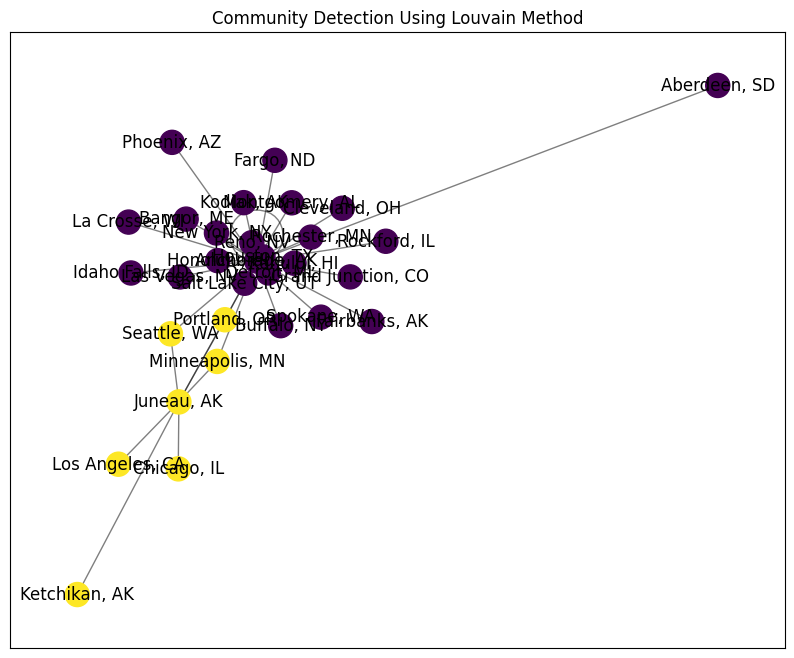

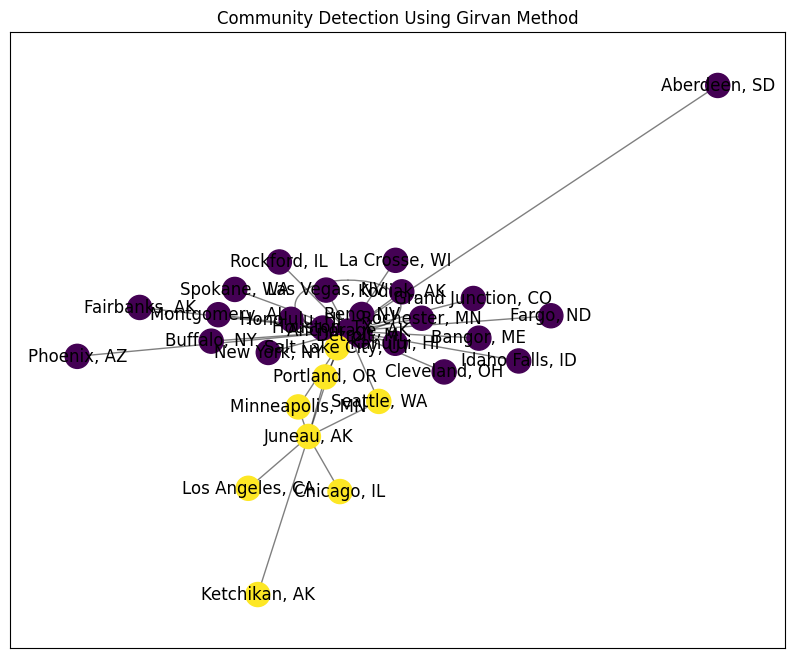

In [93]:
# Visualize Louvain Method
visualize_communities(G, communities_louvain, "Community Detection Using Louvain Method")

# Visualize Girvan-Newman Method
visualize_communities(G, communities_gn, "Community Detection Using Girvan Method")


In [94]:
# Calculate modularity for Louvain communities
modularity_louvain = nx.algorithms.community.modularity(G, communities_louvain)

# Calculate modularity for Girvan-Newman communities
modularity_gn = nx.algorithms.community.modularity(G, communities_gn)

print(f"Modularity (Louvain): {modularity_louvain}")
print(f"Modularity (Girvan-Newman): {modularity_gn}")


Modularity (Louvain): 0.04677369825870377
Modularity (Girvan-Newman): 0.018409507166367925


Given the results of modularity and Jaccard similarity, and considering the sparsity of the graph, we can conclude that:

### Community Overlap (Jaccard Similarity)
The moderate overlap between the communities detected by the **Louvain** and **Girvan-Newman** algorithms suggests that the methods detect similar structures, though not identical. This overlap indicates that both methods are capturing some degree of community structure, but they may highlight different patterns within the network.

### Modularity Differences
The **Louvain** method provides a higher modularity score compared to **Girvan-Newman**, suggesting that the Louvain communities are more cohesive. The **Girvan-Newman** algorithm, however, yields a weaker community structure, which could be due to its approach of iteratively removing edges based on betweenness centrality, which might break the graph into smaller, less cohesive components.

### Impact of Sparsity
The relatively low modularity scores observed in both methods (Louvain: 0.0468, Girvan-Newman: 0.0184) could be influenced by the **sparsity** of the dataset. A sparse graph with fewer edges relative to nodes can lead to poorly connected communities, which lowers the modularity. If the graph is sparse (which can be quantified with the sparsity calculation), this could explain why the community structures detected by both algorithms aren't very distinct or cohesive.


# Algorithmic Question (AQ)
Arya needs to travel between cities using a network of flights. Each flight has a fixed cost (in euros), and she wants to find the cheapest possible way to travel from her starting city to her destination city. However, there are some constraints on the journey:

Arya can make at most k stops during her trip (this means up to k+1 flights).
If no valid route exists within these constraints, the result should be -1.
Given a graph of cities connected by flights, your job is to find the minimum cost for Arya to travel between two specified cities (src to dst) while following the constraints.

### a) Write a pseudocode that describes the algorithm to find the cheapest route with at most k stops.

The algorithm repeatedly extracts the city with the lowest cost from the heap.
If the destination city is reached, the cost is returned.
If the number of stops exceeds k, the algorithm continues to the next iteration.
For each neighboring city, the algorithm calculates the new cost and the number of stops. If this new path is cheaper than any previously recorded path to that neighbor with the same or fewer stops, it updates the records and pushes the new state onto the heap. If the heap is exhausted without finding a valid route to the destination, the function returns -1.
The graph is represented as an adjacency list, where each city points to a list of tuples representing its neighboring cities and the cost to reach them. A min-heap (priority queue) is used to explore the cheapest routes first. The initial state is pushed onto the heap with a cost of 0, the source city, and 0 stops. A dictionary minCost is used to track the minimum cost to reach each city with a specific number of stops.

```
FUNCTION findCheapestPrice(n, flights, src, dst, k):
    // Create a graph representation using an adjacency list
    INITIALIZE graph as a dictionary of lists
    FOR each flight (u, v, cost) in flights:
        APPEND (v, cost) to graph[u]
    
    // Min-heap to store (cost, current_city, stops)
    INITIALIZE minHeap as an empty list
    PUSH (0, src, 0) onto minHeap  // (cost, city, stops)
    
    // Initialize a dictionary to track the minimum cost to reach each city with a certain number of stops
    INITIALIZE minCost as an empty dictionary
    
    WHILE minHeap is not empty:
        POP (cost, current_city, stops) from minHeap
        
        // If we reach the destination city and the number of stops is within the limit
        IF current_city == dst:
            RETURN cost
        
        // If we have made more than k stops, continue to the next iteration
        IF stops > k:
            CONTINUE
        
        // Explore neighbors (adjacent cities)
        FOR each (neighbor, price) in graph[current_city]:
            new_cost = cost + price
            new_stops = stops + 1
            
            // Check if this path is cheaper or if we haven't visited this city with this number of stops
            IF (neighbor, new_stops) NOT IN minCost OR new_cost < minCost[(neighbor, new_stops)]:
                minCost[(neighbor, new_stops)] = new_cost
                PUSH (new_cost, neighbor, new_stops) onto minHeap
    
    // If we exhaust the heap without finding a valid route, return -1
    RETURN -1
```

### b) Implement the algorithm in Python and simulate the given test cases.

In [1]:
import heapq
from collections import defaultdict

def findCheapestPrice(n, flights, src, dst, k):
    graph = defaultdict(list)
    for u, v, cost in flights:
        graph[u].append((v, cost))
    minHeap = []
    heapq.heappush(minHeap, (0, src, 0))  # (cost, city, stops)
    minCost = {}
    while minHeap:
        cost, current_city, stops = heapq.heappop(minHeap)
        if current_city == dst:
            return cost
        if stops > k:
            continue
        for neighbor, price in graph[current_city]:
            new_cost = cost + price
            new_stops = stops + 1
            if (neighbor, new_stops) not in minCost or new_cost < minCost[(neighbor, new_stops)]:
                minCost[(neighbor, new_stops)] = new_cost
                heapq.heappush(minHeap, (new_cost, neighbor, new_stops))
    return -1

test_cases = [
    (4, [[0, 1, 100], [1, 2, 100], [2, 0, 100], [1, 3, 600], [2, 3, 200]], 0, 3, 1, 700),
    (3, [[0, 1, 100], [1, 2, 100], [0, 2, 500]], 0, 2, 1, 200),
    (3, [[0, 1, 100], [1, 2, 100], [0, 2, 500]], 0, 2, 0, 500),
    (4, [[0, 1, 100], [0, 2, 200], [1, 3, 300], [2, 3, 300]], 0, 3, 2, 400),
    (4, [[0, 1, 100], [0, 2, 200], [1, 3, 300], [2, 3, 200]], 0, 3, 2, 400),
    ]

for i, (n, flights, src, dst, k, expected) in enumerate(test_cases):
    result = findCheapestPrice(n, flights, src, dst, k)
    if result == expected:
        print(f"Test case {i + 1}: Expected {expected}, got {result} " + "\033[92m" + "V" + "\033[0m")
    else:
        print(f"Test case {i + 1}: Expected {expected}, got {result} " + "\033[91m" + "X" + "\033[0m")
print("All Passed!")

Test case 1: Expected 700, got 700 V
Test case 2: Expected 200, got 200 V
Test case 3: Expected 500, got 500 V
Test case 4: Expected 400, got 400 V
Test case 5: Expected 400, got 400 V
All Passed!


### c) Analyze the algorithm's efficiency. Provide its time complexity and space complexity, and explain whether it is efficient for large graphs (e.g., n > 100).

**Time Complexity:** The graph is constructed from the list of flights, which takes O(E) time, where E is the number of edges (number of flights). The algorithm uses a priority queue to explore the cheapest routes first. In the worst case, we may push each node multiple times into the heap. The number of unique states we can have in the heap is O(V * (k + 1)), where V is the number of cities and k is the maximum number of stops allowed. This is because for each city, we can have multiple entries corresponding to different numbers of stops. Each insertion and extraction operation on the heap takes O(log(V * (k + 1))). The total time complexity can so be expressed as: O(E + (V * (k + 1)) * log(V * (k + 1)))

**Space complexity**: The space required to store the graph is O(E) for the adjacency list. The heap can store up to O(V * (k + 1)) states in the worst case, leading to a space complexity of O(V * k).The minCost dictionary can also grow to O(V * (k + 1)) in the worst case. The total space complexity is:  O(E + V * k)

If the number of cities increases significantly, the number of edges (E) can grow rapidly, especially in a dense graph where each city is connected to many others. The term O(V * k * log (V * k)) can become a bottleneck if k is also large, as it increases the number of states we need to manage in the heap.

### d) Optimize the algorithm to handle larger graphs. Provide an updated pseudocode and analyze the computational complexity of your optimization.

To optimize the algo we can use a 2D list dp where dp[i][j] represents the minimum cost to reach city i with j stops.  For each possible number of stops, the code iterates through all flights and updates the minimum cost to reach each destination city. The array is initialized to store the minimum costs, with dimensions n x (k + 2), and all values set to infinity. The cost to reach the source city with 0 stops is set to 0. The outer loop iterates through the number of stops from 1 to k + 1. The inner loop iterates through each flight. If the city u can be reached with (stops - 1) stops, the algorithm updates the minimum cost to reach city v with stops stops.

```
FUNCTION findCheapestPrice(n, flights, src, dst, k):
    // Initialize a 2D array to store the minimum prices
    INITIALIZE dp as a 2D array of size n x (k + 2) with all values set to infinity
    
    // Base case: cost to reach the source city with 0 stops is 0
    FOR stops FROM 0 TO k + 1:
        dp[src][stops] = 0

    // Iterate through the number of stops
    FOR stops FROM 1 TO k + 1:
        // Iterate through each flight
        FOR each flight (u, v, price) in flights:
            // If we can reach city u with (stops - 1) stops
            IF dp[u][stops - 1] is not infinity:
                // Update the minimum cost to reach city v with 'stops' stops
                dp[v][stops] = MIN(dp[v][stops], dp[u][stops - 1] + price)

    // Find the minimum price to reach the destination city with at most k stops
    min_price = infinity
    FOR stops FROM 0 TO k + 1:
        min_price = MIN(min_price, dp[dst][stops])
    
    // Return the minimum price if it is not infinity, otherwise return -1
    RETURN min_price if min_price is not infinity else -1
  ```



**Time Complexity**:
The initialization of the 2D array dp takes O(n * (k + 2)) time, where n is the number of cities and k is the maximum number of stops allowed. This is because we are creating a 2D array of size n * (k + 2). Setting the base case for the source city with 0 stops takes O(k + 1) time, as we iterate through the number of stops from 0 to k + 1 . The outer loop iterates through the number of stops from 1 to k + 1, which runs k + 1 times.
The inner loop iterates through each flight. If there are E flights, this loop runs E times. Inside the inner loop, we perform a constant-time operation to update the dp array. Therefore, the total time complexity for this part is: O((k + 1) * E). The final step involves iterating through the dp array for the destination city to find the minimum cost, which takes O(k + 2) time. Combining all parts, the total time complexity can be expressed as: O(n * (k + 2) + (k + 1) * E + (k + 2)) that can be approximated to O(E * k).

**Space Complexity**:
The space required for the dp array is O(n * (k + 2)), which is used to store the minimum costs to reach each city with a certain number of stops. Therefore, the total space complexity is: O(n * k).

In [2]:
def findCheapestPrice_v2(n, flights, src, dst, k):
    dp = [[float('inf')] * (k + 2) for _ in range(n)]
    for stops in range(k + 2):
        dp[src][stops] = 0
    for stops in range(1, k + 2):
        for u, v, price in flights:
            if dp[u][stops - 1] != float('inf'):
                dp[v][stops] = min(dp[v][stops], dp[u][stops - 1] + price)
    min_price = min(dp[dst][stops] for stops in range(k + 2))
    return min_price if min_price != float('inf') else -1

for i, (n, flights, src, dst, k, expected) in enumerate(test_cases):
    result = findCheapestPrice_v2(n, flights, src, dst, k)
    if result == expected:
        print(f"Test case {i + 1}: Expected {expected}, got {result} " + "\033[92m" + "V" + "\033[0m")
    else:
        print(f"Test case {i + 1}: Expected {expected}, got {result} " + "\033[91m" + "X" + "\033[0m")
print("All Passed!")

Test case 1: Expected 700, got 700 V
Test case 2: Expected 200, got 200 V
Test case 3: Expected 500, got 500 V
Test case 4: Expected 400, got 400 V
Test case 5: Expected 400, got 400 V
All Passed!


### e) Ask LLM (e.g., ChatGPT) for an optimized version of your algorithm. Compare its solution to yours in terms of performance, time complexity, and correctness.

In [3]:
def findCheapestPriceLLM(n, flights, src, dst, k):
    # Step 1: Create a graph representation using an adjacency list
    graph = defaultdict(list)
    for u, v, cost in flights:
        graph[u].append((v, cost))
    
    # Step 2: Initialize the priority queue
    minHeap = []
    heapq.heappush(minHeap, (0, src, 0))  # (cost, city, stops)
    
    # Step 3: Initialize a 2D array to track minimum costs
    minCost = [[float('inf')] * (k + 2) for _ in range(n)]
    minCost[src][0] = 0  # Cost to reach src with 0 stops is 0

    while minHeap:
        cost, current_city, stops = heapq.heappop(minHeap)
        
        # Step 4: Check if we reached the destination
        if current_city == dst:
            return cost
        
        # If we have made more than k stops, continue
        if stops > k:
            continue
        
        # Step 5: Explore neighbors
        for neighbor, price in graph[current_city]:
            new_cost = cost + price
            new_stops = stops + 1
            
            # Check if this path is cheaper
            if new_cost < minCost[neighbor][new_stops]:
                minCost[neighbor][new_stops] = new_cost
                heapq.heappush(minHeap, (new_cost, neighbor, new_stops))
    
    # Step 6: If we exhaust the heap without finding a valid route, return -1
    return -1

test_cases = [
    (4, [[0, 1, 100], [1, 2, 100], [2, 0, 100], [1, 3, 600], [2, 3, 200]], 0, 3, 1, 700),
    (3, [[0, 1, 100], [1, 2, 100], [0, 2, 500]], 0, 2, 1, 200),
    (3, [[0, 1, 100], [1, 2, 100], [0, 2, 500]], 0, 2, 0, 500),
    (4, [[0, 1, 100], [0, 2, 200], [1, 3, 300], [2, 3, 300]], 0, 3, 2, 400),
    (4, [[0, 1, 100], [0, 2, 200], [1, 3, 300], [2, 3, 200]], 0, 3, 2, 400),
    ]

for i, (n, flights, src, dst, k, expected) in enumerate(test_cases):
    result = findCheapestPriceLLM(n, flights, src, dst, k)
    if result == expected:
        print(f"Test case {i + 1}: Expected {expected}, got {result} " + "\033[92m" + "V" + "\033[0m")
    else:
        print(f"Test case {i + 1}: Expected {expected}, got {result} " + "\033[91m" + "X" + "\033[0m")
print("All Passed!")

Test case 1: Expected 700, got 700 V
Test case 2: Expected 200, got 200 V
Test case 3: Expected 500, got 500 V
Test case 4: Expected 400, got 400 V
Test case 5: Expected 400, got 400 V
All Passed!


The optimizations made are the usage of the minCost array keeps track of the minimum cost to reach each city with a specific number of stops. This prevents pushing states into the priority queue that are not optimal. The algorithm also immediately returns the cost when the destination city is reached, which can save unnecessary processing. By checking if the new cost is less than the previously recorded cost for that city and number of stops, we ensure an efficient state management, only checking the most promising paths are explored.

**Time Complexity**: The time complexity remains O(E * k log E), where E is the number of flights. The logarithmic factor comes from the priority queue operations.

**Space Complexity**: The space complexity is O(n * (k + 1)) due to the minCost array.

**Comparing solution**: we have that our solution is faster than the solution suggested by the LLM: 
*   Our solution: O(E * k)
*   LLM's solution: O(E * k log E)

It's important to note that bot the solutions use dynamic programming to optimize the original algorithm.